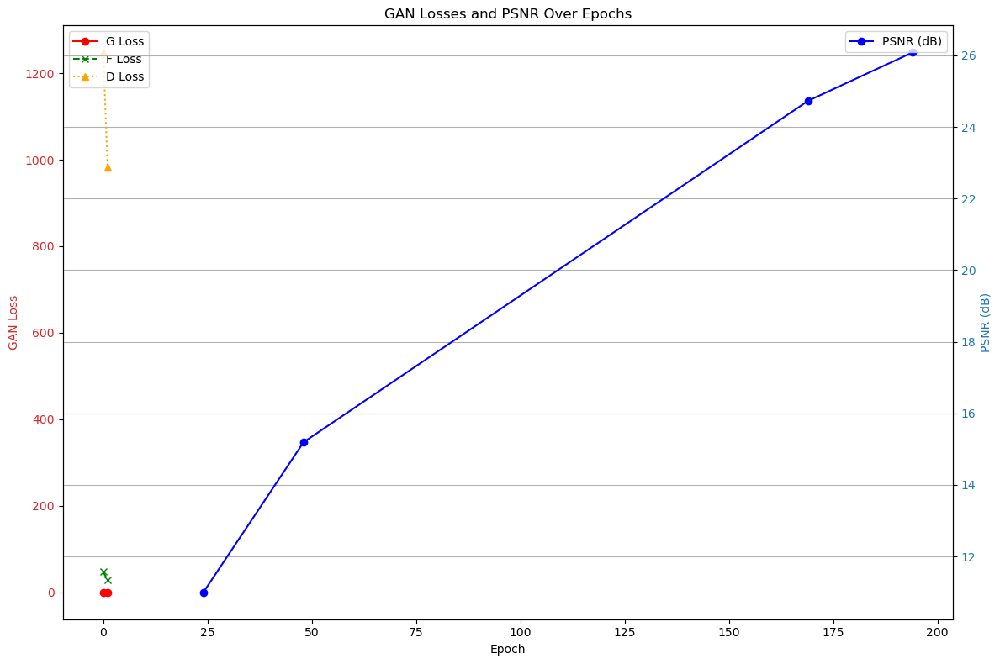

In [1]:
import re
import matplotlib.pyplot as plt

# Log entries to be parsed
logs = """
24-05-01 12:33:55.898 : <epoch:  0, iter:     200, lr:1.000e-03> G_loss: 8.677e-03 F_loss: 4.688e+01 D_loss: 1.248e+03 D_real: -5.158e+04 D_fake: -2.495e+05 
24-05-01 12:40:44.783 : <epoch:  1, iter:     400, lr:1.000e-03> G_loss: 3.437e-03 F_loss: 2.757e+01 D_loss: 9.833e+02 D_real: -5.255e+04 D_fake: -1.967e+05 
24-05-01 15:17:38.281 : <epoch: 24, iter:   5,000, lr:1.000e-03, Average PSNR : 11.00dB
24-05-01 18:08:12.884 : <epoch: 48, iter:  10,000, Average PSNR : 15.19dB
24-05-02 08:20:24.238 : <epoch:169, iter:  35,000, Average PSNR : 24.73dB
24-05-02 11:10:36.328 : <epoch:194, iter:  40,000, Average PSNR : 26.08dB
"""

# Regular expression to extract data from logs
psnr_pattern = r"<epoch:\s*(\d+),\s*iter:\s*(\d+)[^<]*Average PSNR\s*:\s*([\d\.]+)dB"

# Extract PSNR values
matches = re.findall(psnr_pattern, logs)
epochs_psnr = [int(m[0]) for m in matches]
psnr_values = [float(m[2]) for m in matches]

gan_pattern = r"<epoch:\s*(\d+),\s*iter:\s*(\d+)[^>]*> G_loss:\s*([\d\.e\+\-]+)\s*F_loss:\s*([\d\.e\+\-]+)\s*D_loss:\s*([\d\.e\+\-]+)"

# Extract GAN loss values
gan_matches = re.findall(gan_pattern, logs)
epochs_gan = [int(m[0]) for m in gan_matches]
g_losses = [float(m[2]) for m in gan_matches]
f_losses = [float(m[3]) for m in gan_matches]
d_losses = [float(m[4]) for m in gan_matches]

# Creating a combined plot for GAN losses and PSNR

fig, ax1 = plt.subplots(figsize=(12, 8))

# Plotting GAN losses
ax1.set_xlabel('Epoch')
ax1.set_ylabel('GAN Loss', color='tab:red')
ax1.plot(epochs_gan, g_losses, marker='o', color='r', linestyle='-', label='G Loss')
ax1.plot(epochs_gan, f_losses, marker='x', color='g', linestyle='--', label='F Loss')
ax1.plot(epochs_gan, d_losses, marker='^', color='orange', linestyle=':', label='D Loss')
ax1.tick_params(axis='y', labelcolor='tab:red')
ax1.legend(loc='upper left')

# Plotting PSNR values on secondary y-axis
ax2 = ax1.twinx()
ax2.set_ylabel('PSNR (dB)', color='tab:blue')
ax2.plot(epochs_psnr, psnr_values, marker='o', color='b', label='PSNR (dB)')
ax2.tick_params(axis='y', labelcolor='tab:blue')
ax2.legend(loc='upper right')

# Adding grid and title
plt.grid(True)
plt.title('GAN Losses and PSNR Over Epochs')
fig.tight_layout()
plt.show()


In [ ]:
from cmath import e
import matplotlib.pyplot as plt


epochs = list(range(205))
G_losses = [8.677e-03, 3.437e-03, 1.397e-03, 1.770e-03, 1.073e-03, 1.226e-03, 8.501e-04, 6.261e-04, 5.950e-04, 8.485e-04,
            3.111e-04, 9.087e-04, 5.342e-04, 4.222e-04, 1.295e-03, 3.696e-03, 6.512e-04, 5.410e-04, 7.432e-04, 4.429e-04,
            4.920e-04, 2.699e-04, 4.965e-04, 6.154e-04, 7.178e-04, 6.994e-04, 3.791e-04, 3.342e-03, 6.551e-04, 6.295e-04,
            5.138e-04, 6.655e-04, 4.634e-04, 4.424e-04, 5.505e-04, 3.476e-04, 3.907e-04, 3.819e-04, 3.268e-04, 3.436e-04,
            6.106e-04, 2.514e-04, 2.688e-04, 2.310e-04, 1.439e-04, 2.283e-04, 2.442e-04, 2.895e-04, 2.558e-04, 2.962e-04,
            2.830e-04, 2.259e-04, 2.665e-04, 2.282e-04, 2.322e-04, 3.205e-04, 2.425e-04, 2.326e-04, 3.254e-04, 3.629e-04,
            2.264e-04, 3.053e-04, 3.395e-04, 2.767e-04, 3.298e-04, 2.641e-04, 4.987e-04, 2.652e-04, 3.752e-04, 4.138e-04,
            5.050e-04, 2.848e-04, 3.777e-04, 4.019e-04, 4.595e-04, 3.633e-04, 4.924e-04, 4.384e-04, 4.253e-04, 4.336e-04,
            5.150e-04, 5.132e-04, 6.296e-04, 4.207e-04, 6.640e-04, 5.324e-04, 1.034e-03, 2.920e-03, 9.987e-02, 2.140e-02,
            1.890e-02, 3.495e-04, 3.236e-03, 3.100e-03, 2.584e-03, 1.735e-03, 2.607e-03, 1.474e-03, 1.772e-03, 1.261e-03,
            6.495e-04, 4.581e-04, 3.135e-04, 1.680e-04, 1.094e-04, 7.127e-05, 4.507e-05, 7.016e-05, 6.208e-05, 6.030e-05,
            6.302e-05, 4.489e-05, 4.025e-05, 3.671e-05, 4.386e-05, 1.419e-04, 4.726e-05, 4.816e-05, 9.083e-04, 8.754e-05,
            1.672e-04, 1.250e-04, 5.975e-05, 4.474e-05, 3.715e-05, 6.661e-05, 4.860e-05, 5.344e-05, 5.086e-05, 4.359e-05,
            2.815e-05, 4.875e-05, 3.133e-05, 4.287e-05, 3.111e-05, 4.992e-05, 3.531e-05, 2.826e-05, 4.004e-05, 3.161e-05,
            5.759e-05, 4.053e-05, 3.623e-05, 4.601e-05, 5.101e-05, 6.706e-05, 9.810e-05, 5.380e-05, 3.376e-05, 5.812e-05,
            5.222e-05, 5.747e-05, 5.362e-04, 2.851e-05, 4.165e-05, 8.852e-05, 1.002e-04, 8.062e-05, 2.582e-05, 4.739e-05,
            5.800e-05, 8.860e-05, 4.715e-05, 7.018e-05, 2.686e-05, 3.445e-05, 9.614e-05, 1.083e-04, 8.445e-05, 1.246e-04,
            4.934e-05, 5.361e-05, 2.959e-04, 6.030e-05, 5.063e-05, 6.921e-05, 3.306e-05, 1.144e-04, 2.030e-05, 3.417e-04,
            3.520e-05, 2.909e-05]

F_losses = [4.688e+01, 2.757e+01, 1.204e+01, 7.502e+00, 7.239e+00, 8.704e+00, 5.985e+00, 6.411e+00, 6.803e+00, 7.313e+00,
            6.836e+00, 7.117e+00, 5.873e+00, 4.463e+00, 8.593e+00, 7.587e+00, 5.079e+00, 6.002e+00, 6.417e+00, 5.817e+00,
            6.912e+00, 6.959e+00, 5.851e+00, 6.498e+00, 5.880e+00, 5.159e+00, 5.776e+00, 8.909e+00, 7.936e+00, 7.096e+00,
            5.614e+00, 6.198e+00, 5.141e+00, 5.263e+00, 6.601e+00, 8.427e+00, 6.810e+00, 6.321e+00, 7.354e+00, 6.682e+00,
            8.083e+00, 6.467e+00, 5.990e+00, 7.307e+00, 4.951e+00, 6.086e+00, 5.804e+00, 7.339e+00, 6.418e+00, 5.738e+00,
            5.763e+00, 6.933e+00, 4.763e+00, 4.526e+00, 7.731e+00, 4.991e+00, 4.906e+00, 3.581e+00, 4.807e+00, 3.773e+00, 4.044e+00,
             6.227e+00, 3.659e+00, 5.449e+00, 5.264e+00, 5.652e+00, 6.346e+00, 6.464e+00, 4.539e+00, 3.918e+00, 5.217e+00,
             5.407e+00, 7.995e+00, 5.998e+00, 9.383e+01, 7.914e+00, 8.014e+00, 7.608e+00, 7.251e+00, 6.045e+00, 5.488e+00,
             4.656e+00, 6.406e+00, 4.777e+00, 4.351e+00, 5.463e+00, 2.460e+00, 3.792e+00, 3.617e+00, 3.348e+00, 3.503e+00,
             3.806e+00, 3.861e+00, 3.764e+00, 4.202e+00, 3.718e+00, 4.153e+00, 3.816e+00, 2.910e+00, 2.975e+00, 3.362e+00,
             3.573e+00, 3.242e+00, 3.075e+00, 4.430e+00, 5.447e+00, 2.648e+00, 3.392e+00, 2.576e+00, 3.044e+00, 2.825e+00,
             2.617e+00, 4.385e+00, 2.066e+00, 3.815e+00, 3.383e+00, 2.762e+00, 3.952e+00, 2.997e+00, 3.908e+00, 2.281e+00,
             3.266e+00, 2.779e+00, 2.342e+00, 3.727e+00, 2.481e+00, 3.731e+00, 3.476e+00, 3.453e+00, 3.487e+00, 2.793e+00,
             2.585e+00, 2.990e+00, 2.461e+00, 3.412e+00, 3.208e+00, 3.688e+00, 2.339e+00, 2.366e+00, 2.051e+00, 3.394e+00,
             2.916e+00, 2.643e+00, 2.857e+00, 3.663e+00, 2.938e+00, 3.320e+00, 2.397e+00, 2.563e+00, 2.859e+00, 3.602e+00,
             3.073e+00, 2.988e+00, 2.511e+00, 2.315e+00, 2.678e+00, 2.992e+00, 2.572e+00, 2.354e+00, 2.464e+00, 2.781e+00,
             2.015e+00, 3.387e+00, 2.594e+00, 2.286e+00]

D_losses = [1.248e+03, 9.833e+02, 7.980e+02, 8.198e+02, 7.470e+02, 7.264e+02, 8.900e+02, 4.832e+02, 2.812e+02, 2.479e+02,
            1.661e+02, 3.510e+02, 6.841e+02, 3.734e+02, 5.705e+02, 1.427e+01, 1.177e+00, 7.353e-01, 6.791e-01, 6.077e-01,
            5.672e-01, 7.991e-01, 7.800e-01, 9.279e-01, 1.454e+00, 2.197e+00, 1.954e+01, 1.539e+03, 9.001e+02, 7.123e+02,
            5.549e+02, 5.358e+02, 3.732e+02, 4.592e+02, 4.497e+02, 4.227e+02, 4.464e+02, 4.025e+02, 4.483e+02, 4.718e+02,
            3.954e+02, 2.445e-01, -7.838e-03, -2.639e-02, -2.209e-02, -2.252e-02, -2.578e-02, -3.173e-02, -2.869e-02, -3.188e-02,
            -3.197e-02, -2.338e-02, -3.180e-02, -3.163e-02, -3.222e-02, -3.146e-02, -3.415e-02, -3.351e-02, -3.368e-02, -3.380e-02,
            -3.381e-02, -3.198e-02, -3.405e-02, -3.303e-02, -3.390e-02, -3.369e-02, -3.206e-02, -3.492e-02, -3.413e-02, -3.161e-02,
            -3.047e-02, -3.327e-02, -2.927e-02, -3.313e-02, -3.321e-02, -2.714e-02, -3.080e-02, -2.780e-02, -2.926e-02, -2.764e-02,
            -2.633e-02, -2.332e-02, -8.527e-03, -2.203e-02, -2.385e-02, -1.392e-02, -1.077e-02, 8.793e+02, 7.406e-02, 9.737e+00,
            -4.182e-01, 3.624e+02, -8.885e-01, -7.904e-01, -7.450e-01, -7.027e-01, -6.362e-01, -6.196e-01, -6.107e-01, -6.252e-01,
            -6.397e-01, -6.670e-01, -7.050e-01, -7.397e-01, -8.510e-01, -7.816e-01, -6.789e-01, -6.363e-01, -4.000e-01, -3.731e-01,
            -3.351e-01, -3.331e-01, -3.603e-01, -4.184e-01, -3.462e-01, -3.392e-01, -3.458e-01, -2.689e-01, -9.197e-01, -7.600e-01,
            -3.856e-01, -2.818e-01, -2.767e-01, -2.906e-01, -2.558e-01, -2.309e-01, -2.233e-01, -2.060e-01, -2.046e-01, -1.809e-01,
            -2.066e-01, -3.138e-01, -2.151e-01, -2.425e-01, -2.364e-01, -2.945e-01, -2.813e-01, 4.053e-05, 3.623e-05, 4.601e-05, 5.101e-05,
             6.706e-05, 9.810e-05, 5.380e-05, 3.376e-05, 5.812e-05,
            5.222e-05, 5.747e-05, 5.362e-04, 2.851e-05, 4.165e-05, 8.852e-05, 1.002e-04, 8.062e-05, 2.582e-05, 4.739e-05,
            5.800e-05, 8.860e-05, 4.715e-05, 7.018e-05, 2.686e-05, 3.445e-05, 9.614e+02]


In [ ]:
max_epochs = min(len(G_losses), len(F_losses), len(D_losses))
G_losses = G_losses[:max_epochs]
F_losses = F_losses[:max_epochs]
D_losses = D_losses[:max_epochs]
epochs = list(range(max_epochs))

# Plotting the data
plt.figure(figsize=(10, 6))
plt.plot(epochs, G_losses, label='G_loss', marker='o', markersize=3)
plt.plot(epochs, F_losses, label='F_loss', marker='o', markersize=3)
plt.plot(epochs, D_losses, label='D_loss', marker='o', markersize=3)
plt.xlabel('Epochs')
plt.ylabel('Loss Values')
plt.yscale('log')
plt.legend()
plt.title('Loss Values during GAN Training')
plt.grid(True)
plt.show()

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Sample data based on the previously provided logs
data = {
    "Epoch": [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20],
    "Generator Loss": [1.061e-03, 1.084e-03, 8.870e-04, 9.943e-04, 1.382e-03, 1.274e-03, 1.210e-03,
                       1.298e-03, 1.114e-03, 1.149e-03, 8.888e-04, 1.163e-03, 9.901e-04, 9.934e-04,
                       1.204e-03, 1.267e-03, 1.315e-03, 1.356e-03, 1.315e-03, 1.009e-03, 9.831e-04],
    "Discriminator Loss": [2.969e-03, 4.827e-03, 4.510e-03, 4.946e-03, 4.783e-03, 4.912e-03, 4.771e-03,
                           4.927e-03, 4.833e-03, 5.022e-03, 4.852e-03, 4.856e-03, 4.779e-03, 4.887e-03,
                           4.297e-03, 5.006e-03, 5.057e-03, 4.900e-03, 5.016e-03, 4.925e-03, 4.934e-03],
    "PSNR": [13.56, 14.16, 13.29, 14.10, 12.56, 12.71, 12.30, 12.37, 12.90, 14.34, 15.14, 16.39,
             18.89, 19.71, 21.08, 21.27, 20.18, 19.76, 19.39, 20.74, 21.41]  # Sample PSNR data
}

# Creating a DataFrame
df = pd.DataFrame(data)

# Plotting
fig, ax1 = plt.subplots(figsize=(10, 6))

color = 'tab:red'
ax1.set_xlabel('Epoch')
ax1.set_ylabel('Loss', color=color)
ax1.plot(df['Epoch'], df['Generator Loss'], label='Generator Loss', color='red')
ax1.plot(df['Epoch'], df['Discriminator Loss'], label='Discriminator Loss', color='green', linestyle='--')
ax1.tick_params(axis='y', labelcolor=color)
ax1.legend(loc='upper left')

ax2 = ax1.twinx()
color = 'tab:blue'
ax2.set_ylabel('PSNR (dB)', color=color)
ax2.plot(df['Epoch'], df['PSNR'], label='PSNR', color=color, linestyle='-.')
ax2.tick_params(axis='y', labelcolor=color)
ax2.legend(loc='upper right')

plt.title('Training Progress: Loss and PSNR over Epochs GATN')
plt.show()


In [ ]:
import torch
import torch.nn.functional as F

# Assume img is your input image tensor of shape [1, Channels, Height, Width]
# Let's create a random image tensor for demonstration
channels, height, width = 3, 128, 128  # Example dimensions
img = torch.randn(1, channels, height, width)

block_size = 16
stride = 8  # 50% overlap

# Step 1: Divide into overlapping blocks
unfolded = F.unfold(img, kernel_size=block_size, stride=stride)

# Step 2: Manipulate blocks (if needed, you can process your blocks here)

# Step 3: Reconstruct the image
# Reconstructing the image
reconstructed = F.fold(unfolded, output_size=(height, width), kernel_size=block_size, stride=stride)

# Correction factor for overlapping patches
# Create a ones tensor of the same shape as img
one_tensor = torch.ones_like(img)
unfolded_ones = F.unfold(one_tensor, kernel_size=block_size, stride=stride)
corrected_ones = F.fold(unfolded_ones, output_size=(height, width), kernel_size=block_size, stride=stride)

# Normalize the reconstructed image by the correction tensor
reconstructed /= corrected_ones

# Check if the reconstruction is perfect
print("Reconstruction error (should be close to 0):", torch.norm(img - reconstructed).item())


In [ ]:
from PIL import Image
import torchvision.transforms as transforms
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt

# Load and transform image
image_path = '/home/ozkan/works/n-smoe/utils/test.png'
image = Image.open(image_path).convert('RGB')
transform = transforms.Compose([
    transforms.Resize((128, 128)),
    transforms.ToTensor(),
])
img = transform(image).unsqueeze(0)

# Image processing parameters
channels, height, width = 3, 128, 128
block_size = 16
stride = 8

# Divide into overlapping blocks
unfolded = F.unfold(img, kernel_size=block_size, stride=stride)

# Reconstruct the image
reconstructed = F.fold(unfolded, output_size=(height, width), kernel_size=block_size, stride=stride)

# Correction for overlapping patches
one_tensor = torch.ones_like(img)
unfolded_ones = F.unfold(one_tensor, kernel_size=block_size, stride=stride)
corrected_ones = F.fold(unfolded_ones, output_size=(height, width), kernel_size=block_size, stride=stride)
reconstructed /= corrected_ones

# Verify reconstruction
print("Reconstruction error (should be close to 0):", torch.norm(img - reconstructed).item())

# Plot the original and reconstructed images
fig, ax = plt.subplots(1, 2, figsize=(12, 6))
ax[0].imshow(transforms.ToPILImage()(img.squeeze(0)))
ax[0].set_title('Original Image')
ax[0].axis('off')

ax[1].imshow(transforms.ToPILImage()(reconstructed.squeeze(0)))
ax[1].set_title('Reconstructed Image')
ax[1].axis('off')

plt.show()


In [ ]:
unfolded.shape

In [36]:
import torch
import torchvision.transforms as transforms
from PIL import Image
import matplotlib.pyplot as plt
import cupy as cp
# import cuda_block_ops
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")



def load_image(image_path):
    image = Image.open(image_path)
    transform = transforms.ToTensor()
    return transform(image).to(device)  # Move tensor to GPU


def extract_blocks(img_tensor, block_size, overlap):
    blocks = []
    step = block_size - overlap
    for i in range(0, img_tensor.shape[1] - block_size + 1, step):
        for j in range(0, img_tensor.shape[2] - block_size + 1, step):
            block = img_tensor[:, i:i+block_size, j:j+block_size]
            blocks.append(block)
    return torch.stack(blocks).to(device)  


# def reconstruct_image(blocks, original_dims, block_size, overlap):
#     height, width = original_dims
#     step = block_size - overlap
#     recon_image = torch.zeros(3, height, width).to(device)
#     count_matrix = torch.zeros(3, height, width).to(device)

#     idx = 0
#     for i in range(0, height - block_size + 1, step):
#         for j in range(0, width - block_size + 1, step):
#             recon_image[:, i:i+block_size, j:j+block_size] += blocks[idx]
#             count_matrix[:, i:i+block_size, j:j+block_size] += 1
#             idx += 1

#     recon_image /= count_matrix
#     return recon_image

def generate_gaussian_window(block_size, sigma=1.0):
    coords = torch.arange(block_size).to(device)
    coords = coords - block_size // 2
    gauss = torch.exp(-0.5 * (coords.float() / sigma) ** 2)
    gauss2d = gauss[:, None] * gauss[None, :]
    return gauss2d / gauss2d.max()

def reconstruct_image(blocks, original_dims, block_size, overlap):
    height, width = original_dims
    step = block_size - overlap
    recon_image = torch.zeros(3, height, width).to(device)
    count_matrix = torch.zeros(3, height, width).to(device)

    gaussian_window = generate_gaussian_window(block_size)

    idx = 0
    for i in range(0, height - block_size + 1, step):
        for j in range(0, width - block_size + 1, step):
            weighted_block = blocks[idx] * gaussian_window
            recon_image[:, i:i+block_size, j:j+block_size] += weighted_block
            count_matrix[:, i:i+block_size, j:j+block_size] += gaussian_window
            idx += 1

    epsilon = 1e-8
    recon_image /= (count_matrix + epsilon)
    return recon_image

image_path = './test.png'
image_tensor = load_image(image_path)
blocks = extract_blocks(image_tensor, 16, 1) # cuda_block_ops.extract_blocks(image_tensor, 16, 1) # extract_blocks(image_tensor, 16, 1)
reconstructed_image = reconstruct_image(blocks, image_tensor.shape[1:], 16, 1)
# reconstructed_image = cuda_block_ops.extract_blocks(blocks, image_tensor.shape[1:], 16, 1) # reconstruct_image(blocks, image_tensor.shape[1:], 16, 1)

In [37]:
reconstructed_image

tensor([[[3.7737e-22, 7.9601e-19, 7.5637e-16,  ..., 0.0000e+00,
          0.0000e+00, 0.0000e+00],
         [9.0973e-19, 1.8504e-15, 1.3676e-12,  ..., 0.0000e+00,
          0.0000e+00, 0.0000e+00],
         [9.0765e-16, 1.6411e-12, 1.0006e-09,  ..., 0.0000e+00,
          0.0000e+00, 0.0000e+00],
         ...,
         [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
          0.0000e+00, 0.0000e+00],
         [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
          0.0000e+00, 0.0000e+00],
         [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
          0.0000e+00, 0.0000e+00]],

        [[3.1447e-22, 3.4115e-19, 1.5127e-16,  ..., 0.0000e+00,
          0.0000e+00, 0.0000e+00],
         [3.4115e-19, 2.0560e-16, 0.0000e+00,  ..., 0.0000e+00,
          0.0000e+00, 0.0000e+00],
         [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
          0.0000e+00, 0.0000e+00],
         ...,
         [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
          0.000

(np.float64(-0.5), np.float64(1023.5), np.float64(1023.5), np.float64(-0.5))

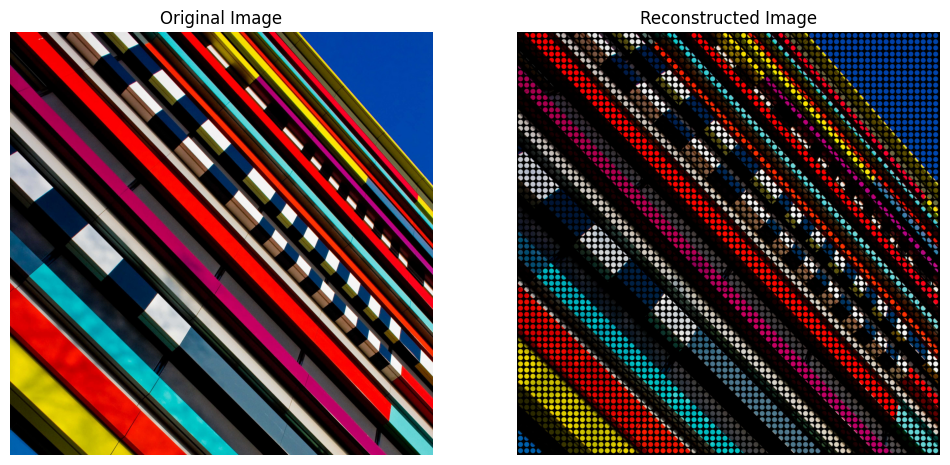

In [38]:
fig, ax = plt.subplots(1, 2, figsize=(12, 6))
ax[0].imshow(transforms.ToPILImage()(image_tensor.squeeze(0)))
ax[0].set_title('Original Image')
ax[0].axis('off')

ax[1].imshow(transforms.ToPILImage()(reconstructed_image.squeeze(0)))
ax[1].set_title('Reconstructed Image')
ax[1].axis('off')

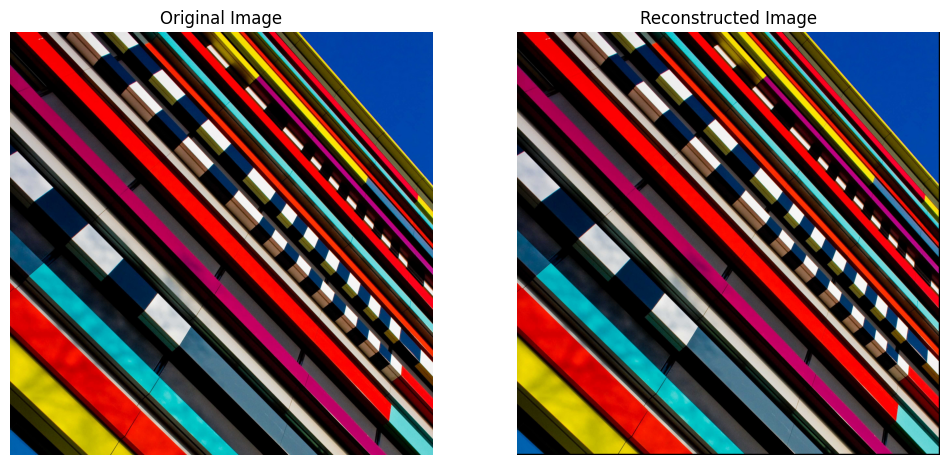

In [12]:
fig, ax = plt.subplots(1, 2, figsize=(12, 6))
ax[0].imshow(transforms.ToPILImage()(image_tensor.squeeze(0)))
ax[0].set_title('Original Image')
ax[0].axis('off')

ax[1].imshow(transforms.ToPILImage()(reconstructed_image.squeeze(0)))
ax[1].set_title('Reconstructed Image')
ax[1].axis('off')

plt.show()

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision
import functools
from typing import TypeVar, Generic, Literal, TypedDict
from dataclasses import dataclass

class BatchedViews(TypedDict):
    image: torch.FloatTensor  # Shape: [batch, channels, height, width]

T = TypeVar('T')

class Backbone(nn.Module, Generic[T]):
    def __init__(self, cfg: T):
        super().__init__()
        self.cfg = cfg

    def forward(self, context: BatchedViews) -> torch.FloatTensor:
        raise NotImplementedError

    @property
    def d_out(self) -> int:
        raise NotImplementedError

@dataclass
class BackboneResnetCfg:
    name: Literal["resnet"]
    model: Literal["resnet18", "resnet34", "resnet50", "resnet101", "resnet152", "dino_resnet50"]
    num_layers: int
    use_first_pool: bool
    d_out: int

class BackboneResnet(Backbone[BackboneResnetCfg]):
    def __init__(self, cfg: BackboneResnetCfg):
        super().__init__(cfg)
        norm_layer = functools.partial(nn.InstanceNorm2d, affine=False, track_running_stats=False)
        model = getattr(torchvision.models, cfg.model)(pretrained=False, norm_layer=norm_layer)
        # Remove the last fully connected layer and average pooling layer
        self.model = nn.Sequential(*list(model.children())[:-2])
        
        self.projections = nn.ModuleDict()
        out_channels = self.model[-1][-1].conv3.out_channels if hasattr(self.model[-1][-1], 'conv3') else 256
        for index in range(cfg.num_layers):
            self.projections[f'layer{index}'] = nn.Conv2d(out_channels, cfg.d_out, 1)

    def forward(self, context: BatchedViews) -> torch.FloatTensor:
        x = context['image']
        x = self.model(x)
        features = [self.projections[f'layer{index}'](x) for index in range(self.cfg.num_layers)]
        output = torch.stack(features).sum(dim=0)
        return output

    @property
    def d_out(self) -> int:
        return self.cfg.d_out

cfg = BackboneResnetCfg('resnet', 'resnet50', 5, False, 256)
model = BackboneResnet(cfg)
dummy_data = torch.rand(3, 3, 224, 224)  # Batch size of 3, 3 channels, 224x224 each
context = BatchedViews(image=dummy_data)
output = model(context)
print(f'Output shape: {output.shape}')


In [ ]:
import functools
from dataclasses import dataclass
from typing import Literal

import torch
import torch.nn.functional as F
import torchvision
from einops import rearrange
from jaxtyping import Float
from torch import Tensor, nn
from torchvision.models import ResNet

from typing import Callable, Literal, TypedDict

from jaxtyping import Float, Int64
from torch import Tensor

from abc import ABC, abstractmethod
from typing import Generic, TypeVar


class BatchedViews(TypedDict, total=False):
    extrinsics: Float[Tensor, "batch _ 4 4"]  # batch view 4 4
    intrinsics: Float[Tensor, "batch _ 3 3"]  # batch view 3 3
    image: Float[Tensor, "batch _ _ _ _"]  # batch view channel height width
    near: Float[Tensor, "batch _"]  # batch view
    far: Float[Tensor, "batch _"]  # batch view
    index: Int64[Tensor, "batch _"]  # batch view

T = TypeVar("T")


class Backbone(nn.Module, ABC, Generic[T]):
    cfg: T

    def __init__(self, cfg: T) -> None:
        super().__init__()
        self.cfg = cfg

    @abstractmethod
    def forward(
        self,
        context: BatchedViews,
    ) -> Float[Tensor, "batch view d_out height width"]:
        pass

    @property
    @abstractmethod
    def d_out(self) -> int:
        pass



@dataclass
class BackboneResnetCfg:
    name: Literal["resnet"]
    model: Literal[
        "resnet18", "resnet34", "resnet50", "resnet101", "resnet152", "dino_resnet50"
    ]
    num_layers: int
    use_first_pool: bool
    d_out: int


class BackboneResnet(Backbone[BackboneResnetCfg]):
    model: ResNet

    def __init__(self, cfg: BackboneResnetCfg, d_in: int) -> None:
        super().__init__(cfg)

        assert d_in == 3

        norm_layer = functools.partial(
            nn.InstanceNorm2d,
            affine=False,
            track_running_stats=False,
        )

        if cfg.model == "dino_resnet50":
            self.model = torch.hub.load("facebookresearch/dino:main", "dino_resnet50")
        else:
            self.model = getattr(torchvision.models, cfg.model)(norm_layer=norm_layer)

        # Set up projections
        self.projections = nn.ModuleDict({})
        for index in range(1, cfg.num_layers):
            key = f"layer{index}"
            block = getattr(self.model, key)
            conv_index = 1
            try:
                while True:
                    d_layer_out = getattr(block[-1], f"conv{conv_index}").out_channels
                    conv_index += 1
            except AttributeError:
                pass
            self.projections[key] = nn.Conv2d(d_layer_out, cfg.d_out, 1)

        # Add a projection for the first layer.
        self.projections["layer0"] = nn.Conv2d(
            self.model.conv1.out_channels, cfg.d_out, 1
        )

    def forward(
        self,
        context: BatchedViews,
    ) -> Float[Tensor, "batch view d_out height width"]:
        # Merge the batch dimensions.
        b, v, _, h, w = context["image"].shape
        x = rearrange(context["image"], "b v c h w -> (b v) c h w")

        # Run the images through the resnet.
        x = self.model.conv1(x)
        x = self.model.bn1(x)
        x = self.model.relu(x)
        features = [self.projections["layer0"](x)]

        # Propagate the input through the resnet's layers.
        for index in range(1, self.cfg.num_layers):
            key = f"layer{index}"
            if index == 0 and self.cfg.use_first_pool:
                x = self.model.maxpool(x)
            x = getattr(self.model, key)(x)
            features.append(self.projections[key](x))

        # Upscale the features.
        features = [
            F.interpolate(f, (h, w), mode="bilinear", align_corners=True)
            for f in features
        ]
        features = torch.stack(features).sum(dim=0)

        # Separate batch dimensions.
        return rearrange(features, "(b v) c h w -> b v c h w", b=b, v=v)

    @property
    def d_out(self) -> int:
        return self.cfg.d_out


In [ ]:
import unittest
import torch
from torchvision.models import resnet50

class TestBackboneResnet(unittest.TestCase):
    def setUp(self):
        
        self.config = BackboneResnetCfg(
            name="resnet",
            model="resnet50",
            num_layers=3,
            use_first_pool=True,
            d_out=10
        )
        self.model = BackboneResnet(self.config, d_in=3)
        self.input_tensor = torch.randn(2, 1, 3, 224, 224)
        self.context = BatchedViews(image=self.input_tensor)

    def test_forward_pass(self):
       
        output = self.model(self.context)

       
        expected_shape = (2, 1, self.config.d_out, 224, 224)
        self.assertEqual(output.shape, expected_shape, "The output shape should match the expected shape")

     
        self.assertEqual(output.dtype, torch.float32, "Output tensor should have float32 data type")


In [ ]:
unittest.main(argv=['first-arg-is-ignored'], exit=False)

In [ ]:
import functools
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision
from dataclasses import dataclass
from typing import TypeVar, Generic, Literal, TypedDict

class BatchedViews(TypedDict):
    image: torch.Tensor

T = TypeVar("T")

class Backbone(nn.Module, Generic[T]):
    def __init__(self, cfg: T):
        super().__init__()
        self.cfg = cfg

    def forward(self, context: BatchedViews) -> torch.Tensor:
        raise NotImplementedError

    @property
    def d_out(self) -> int:
        raise NotImplementedError

@dataclass
class BackboneResnetCfg:
    name: Literal["resnet"]
    model: Literal["resnet18", "resnet34", "resnet50", "resnet101", "resnet152", "dino_resnet50"]
    num_layers: int
    use_first_pool: bool
    d_out: int

class BackboneResnet(Backbone[BackboneResnetCfg]):
    def __init__(self, cfg: BackboneResnetCfg, d_in: int):
        super().__init__(cfg)
        assert d_in == 3, "Input depth should be 3 for RGB images"
        
        norm_layer = functools.partial(nn.InstanceNorm2d, affine=False, track_running_stats=False)
        self.model = getattr(torchvision.models, cfg.model)(pretrained=False, norm_layer=norm_layer)

        self.projections = nn.ModuleDict()
        previous_output_channels = self.model.conv1.out_channels  
        self.projections['layer0'] = nn.Conv2d(previous_output_channels, cfg.d_out, 1)

        layers = [self.model.layer1, self.model.layer2, self.model.layer3, self.model.layer4]
        for i, layer_group in enumerate(layers[:cfg.num_layers - 1]):
            
            output_channels = layer_group[-1].conv3.out_channels
            self.projections[f'layer{i+1}'] = nn.Conv2d(output_channels, cfg.d_out, 1)

    def forward(self, context: BatchedViews) -> torch.Tensor:
        x = context['image']
        x = self.model.conv1(x)
        x = self.model.bn1(x)
        x = self.model.relu(x)
        
        features = [self.projections['layer0'](x)]
        layers = [self.model.layer1, self.model.layer2, self.model.layer3, self.model.layer4]
        for index in range(1, self.cfg.num_layers):
            x = layers[index - 1](x)
            features.append(self.projections[f'layer{index}'](x))
        
        h, w = context['image'].shape[2:]
        features = [F.interpolate(feature, (h, w), mode='bilinear', align_corners=True) for feature in features]
        output = torch.stack(features).sum(dim=0)
        return output

    @property
    def d_out(self) -> int:
        return self.cfg.d_out



In [ ]:
config = BackboneResnetCfg(
name="resnet",
model="resnet50", # Use resnet50 as an example model
num_layers=4, # Number of layers to use in projections
use_first_pool=True,
d_out=10 # Number of output channels
)



# Initialize the BackboneResnet model
model = BackboneResnet(config, d_in=3)

# Create a dummy BatchedViews with random data
dummy_data = torch.randn(3, 3, 224, 224)  # Simulate 3 batches, 3 color channels, 224x224 image size
context = BatchedViews(image=dummy_data)

# Perform the forward pass
output = model(context)
print("Output shape:", output.shape) 

In [ ]:
import torch

x = torch.tensor([1000.0, 1001.0, 999.0])
e_direct = torch.exp(x)
sum_e_direct = torch.sum(e_direct)
log_sum_exp_e = torch.log(sum_e_direct)

# Using log-sum-exp trick
max_x = torch.max(x)
log_sum_exp_trick = max_x + torch.log(torch.sum(torch.exp(x - max_x)))

print("Direct Log-Sum-Exp:", log_sum_exp_e)
print("Log-Sum-Exp Trick:", log_sum_exp_trick)


In [ ]:
import math
from dataclasses import dataclass
from typing import Generic, Optional, TypeVar

import torch
import torch.nn as nn
import torch.nn.functional as F
from einops import rearrange
from utils_n.nn import avg_pool_nd, checkpoint, conv_nd, zero_module, GroupNorm32

def normalization(channels, groups):
    return nn.GroupNorm(groups, channels)

T = TypeVar("T")

class Backbone(nn.Module, Generic[T]):
    def __init__(self, cfg: T):
        super().__init__()
        self.cfg = cfg

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        raise NotImplementedError

    @property
    def d_out(self) -> int:
        raise NotImplementedError


In [ ]:
@dataclass
class AttentionBlockConfig:
    channels: int = 3
    num_heads: int = 1
    num_head_channels: int = -1
    use_checkpoint: bool = False
    use_new_attention_order: bool = False
    use_self_attention: bool = False
    num_groups: int = 32

class AttentionBlock(Backbone[AttentionBlockConfig]):
    def __init__(self, cfg: AttentionBlockConfig):
        super().__init__(cfg)
        if cfg.num_head_channels == -1:
            self.num_heads = cfg.num_heads
        else:
            assert (
                cfg.channels % cfg.num_head_channels == 0
            ), f"q,k,v channels {cfg.channels} is not divisible by num_head_channels {cfg.num_head_channels}"
            self.num_heads = cfg.channels // cfg.num_head_channels

        self.norm = normalization(cfg.channels, cfg.num_groups)
        self.qkv = conv_nd(1, cfg.channels, cfg.channels * 3, 1)

        if cfg.use_self_attention:
            self.attention = SelfAttention(cfg.channels, self.num_heads)
        elif cfg.use_new_attention_order:
            self.attention = QKVAttention(self.num_heads)
        else:
            self.attention = QKVAttentionLegacy(self.num_heads)

        self.proj_out = zero_module(conv_nd(1, cfg.channels, cfg.channels, 1))

    def forward(self, x):
        return checkpoint(self._forward, (x,), self.parameters(), self.cfg.use_checkpoint)

    def _forward(self, x):
        b, c, *spatial = x.shape
        x = x.reshape(b, c, -1)
        qkv = self.qkv(self.norm(x))
        if self.cfg.use_self_attention:
            qkv = qkv.permute(0, 2, 1)  # B, C, N to B, N, C for SelfAttention
            h = self.attention(qkv)
            h = h.permute(0, 2, 1)  # B, N, C back to B, C, N
        else:
            h = self.attention(qkv)
        h = self.proj_out(h)
        return (x + h).reshape(b, c, *spatial)

class QKVAttentionLegacy(nn.Module):
    def __init__(self, n_heads):
        super().__init__()
        self.n_heads = n_heads

    def forward(self, qkv):
        bs, width, length = qkv.shape
        assert width % (3 * self.n_heads) == 0
        ch = width // (3 * self.n_heads)
        q, k, v = qkv.reshape(bs * self.n_heads, ch * 3, length).split(ch, dim=1)
        scale = 1 / math.sqrt(math.sqrt(ch))
        weight = torch.einsum(
            "bct,bcs->bts", q * scale, k * scale
        )
        weight = torch.softmax(weight.float(), dim=-1).type(weight.dtype)
        a = torch.einsum("bts,bcs->bct", weight, v)
        return a.reshape(bs, -1, length)

class QKVAttention(nn.Module):
    def __init__(self, n_heads):
        super().__init__()
        self.n_heads = n_heads

    def forward(self, qkv):
        bs, width, length = qkv.shape
        assert width % (3 * self.n_heads) == 0
        ch = width // (3 * self.n_heads)
        q, k, v = qkv.chunk(3, dim=1)
        scale = 1 / math.sqrt(math.sqrt(ch))
        weight = torch.einsum(
            "bct,bcs->bts",
            (q * scale).view(bs * self.n_heads, ch, length),
            (k * scale).view(bs * self.n_heads, ch, length),
        )
        weight = torch.softmax(weight.float(), dim=-1).type(weight.dtype)
        a = torch.einsum(
            "bts,bcs->bct", weight, v.reshape(bs * self.n_heads, ch, length)
        )
        return a.reshape(bs, -1, length)

class SelfAttention(nn.Module):
    def __init__(self, dim, num_heads=8, dropout=0.1):
        super().__init__()
        self.num_heads = num_heads
        self.scale = dim ** -0.5

        self.qkv = nn.Linear(dim, dim * 3, bias=False)
        self.attn_drop = nn.Dropout(dropout)
        self.proj = nn.Linear(dim, dim)
        self.proj_drop = nn.Dropout(dropout)

    def forward(self, x):
        B, N, C = x.shape
        qkv = self.qkv(x).chunk(3, dim=-1)
        q, k, v = map(lambda t: rearrange(t, 'b n (h d) -> b h n d', h=self.num_heads), qkv)

        dots = (q @ k.transpose(-2, -1)) * self.scale
        attn = dots.softmax(dim=-1)
        attn = self.attn_drop(attn)

        out = (attn @ v)
        out = rearrange(out, 'b h n d -> b n (h d)')
        out = self.proj(out)
        out = self.proj_drop(out)
        return out

In [ ]:
cfg = AttentionBlockConfig(
    channels=64,
    num_heads=4,
    num_head_channels=16,
    use_checkpoint=True,
    use_self_attention=True,
    num_groups=32
)

attention_block = AttentionBlock(cfg)

# Create a dummy input tensor
input_tensor = torch.randn(2, 64, 32, 32)  # Batch size of 2, 64 channels, 32x32 spatial dimensions

# Forward pass
output_tensor = attention_block(input_tensor)
print(output_tensor.shape)


In [ ]:
file_path = "https://upload.wikimedia.org/wikipedia/commons/f/fe/Giant_Panda_in_Beijing_Zoo_1.JPG" #@param {type:"string"}
image_file = 'panda.jpg'
!wget {file_path} -O {image_file}


In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision.transforms.functional import resize
from torchvision.transforms import InterpolationMode
from PIL import Image
import matplotlib.pyplot as plt
import torchvision.transforms as transforms

class MullerResizer(nn.Module):
    """Learned Laplacian resizer in PyTorch, fixed Gaussian blur for channel handling."""

    def __init__(
        self,
        base_resize_method="bilinear",
        antialias=False,
        kernel_size=5,
        stddev=1.0,
        num_layers=2,
        avg_pool=False,
        dtype=torch.float32,
        init_weights=None,
        name="muller_resizer",
    ):
        super(MullerResizer, self).__init__()
        self.name = name
        self.base_resize_method = base_resize_method
        self.antialias = (
            antialias  # Note: PyTorch does not support antialiasing in resizing.
        )
        self.kernel_size = kernel_size
        self.stddev = stddev
        self.num_layers = num_layers
        self.avg_pool = avg_pool
        self.dtype = dtype

        self.weights = nn.ParameterList()
        self.biases = nn.ParameterList()
        for layer in range(num_layers):
            weight = nn.Parameter(
                torch.zeros(1, dtype=dtype)
                if init_weights is None
                else torch.tensor([init_weights[2 * layer]], dtype=dtype)
            )
            bias = nn.Parameter(
                torch.zeros(1, dtype=dtype)
                if init_weights is None
                else torch.tensor([init_weights[2 * layer + 1]], dtype=dtype)
            )
            self.weights.append(weight)
            self.biases.append(bias)

    def _base_resizer(self, inputs, target_size):
        if self.avg_pool:
            stride_h = inputs.shape[2] // target_size[0]
            stride_w = inputs.shape[3] // target_size[1]
            if stride_h > 1 and stride_w > 1:
                inputs = F.avg_pool2d(
                    inputs,
                    kernel_size=(stride_h, stride_w),
                    stride=(stride_h, stride_w),
                )
        return F.interpolate(
            inputs, size=target_size, mode=self.base_resize_method, align_corners=False
        )

    def _gaussian_blur(self, inputs):
        sigma = max(self.stddev, 0.5)  # Ensure sigma is not too small
        radius = self.kernel_size // 2
        kernel_size = 2 * radius + 1
        x_coord = (
            torch.arange(kernel_size, dtype=inputs.dtype, device=inputs.device) - radius
        )
        y_grid = x_coord.repeat(kernel_size, 1)
        x_grid = x_coord.view(-1, 1).repeat(1, kernel_size)
        xy_grid = torch.sqrt(x_grid**2 + y_grid**2)
        kernel = torch.exp(-(xy_grid**2) / (2 * sigma**2))
        kernel_sum = kernel.sum()
        if kernel_sum.item() == 0:
            kernel += 1e-10
        kernel /= kernel_sum

        kernel = kernel.view(1, 1, kernel_size, kernel_size).repeat(
            inputs.shape[1], 1, 1, 1
        )
        blurred = F.conv2d(inputs, kernel, padding=radius, groups=inputs.shape[1])
        return blurred

    def forward(self, inputs, target_size):
        inputs = inputs.to(dtype=self.dtype)
        net = self._base_resizer(inputs, target_size)
        for weight, bias in zip(self.weights, self.biases):
            blurred = self._gaussian_blur(inputs)
            residual_image = blurred - inputs
            resized_residual = self._base_resizer(residual_image, target_size)
            scaled_residual = weight * resized_residual + bias
            # net += torch.tanh(scaled_residual.clamp(min=-3, max=3))  # Old. Clamping to prevent extreme values
            net += F.relu(scaled_residual.clamp(min=0, max=1))
            inputs = blurred
        return net

def test_muller_resizer(image_path):
    image = Image.open(image_path).convert('RGB')
    transform = transforms.ToTensor()
    tensor = transform(image)

    resizer = MullerResizer(
        base_resize_method=InterpolationMode.BILINEAR,
        antialias=True,
        kernel_size=5,
        stddev=1.0,
        num_layers=2,
        avg_pool=False,
        dtype=torch.float32,
        init_weights=[1.892, -0.014, -11.295, 0.003],  # Example weights
        name='muller_resizer'
    )

    output = resizer(tensor)
    output_image = transforms.ToPILImage()(output.squeeze(0))  

    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.imshow(image)
    plt.title('Original Image')
    plt.axis('off')
    plt.subplot(1, 2, 2)
    plt.imshow(output_image)
    plt.title('Resized Image')
    plt.axis('off')
    plt.show()


image_path = '/home/ozkan/works/n-smoe/panda.jpg'  


test_muller_resizer(image_path)


In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision.transforms import InterpolationMode
from PIL import Image
import matplotlib.pyplot as plt
import torchvision.transforms as transforms
import numpy as np

class MullerResizer_1(nn.Module):
    """Learned Laplacian resizer in PyTorch, fixed Gaussian blur for channel handling."""

    def __init__(
        self,
        target_size=(224, 224),
        base_resize_method="bilinear",
        antialias=False,
        kernel_size=5,
        stddev=1.0,
        num_layers=2,
        avg_pool=False,
        dtype=torch.float32,
        init_weights=None,
        name="muller_resizer",
    ):
        super(MullerResizer, self).__init__()
        self.target_size = target_size
        self.base_resize_method = base_resize_method
        self.antialias = antialias
        self.kernel_size = kernel_size
        self.stddev = stddev
        self.num_layers = num_layers
        self.avg_pool = avg_pool
        self.dtype = dtype

        self.weights = nn.ParameterList()
        self.biases = nn.ParameterList()
        for layer in range(num_layers):
            weight = nn.Parameter(
                torch.zeros(1, dtype=dtype)
                if init_weights is None
                else torch.tensor([init_weights[2 * layer]], dtype=dtype)
            )
            bias = nn.Parameter(
                torch.zeros(1, dtype=dtype)
                if init_weights is None
                else torch.tensor([init_weights[2 * layer + 1]], dtype=dtype)
            )
            self.weights.append(weight)
            self.biases.append(bias)

    def _base_resizer(self, inputs):
        if self.avg_pool:
            stride_h = inputs.shape[2] // self.target_size[0]
            stride_w = inputs.shape[3] // self.target_size[1]
            if stride_h > 1 and stride_w > 1:
                inputs = F.avg_pool2d(
                    inputs,
                    kernel_size=(stride_h, stride_w),
                    stride=(stride_h, stride_w),
                )
        return F.interpolate(
            inputs, size=self.target_size, mode=self.base_resize_method, align_corners=False
        )

    def _gaussian_blur(self, inputs):
        sigma = max(self.stddev, 0.5)  # Ensure sigma is not too small
        radius = self.kernel_size // 2
        kernel_size = 2 * radius + 1
        x_coord = (
            torch.arange(kernel_size, dtype=inputs.dtype, device=inputs.device) - radius
        )
        y_grid = x_coord.repeat(kernel_size, 1)
        x_grid = x_coord.view(-1, 1).repeat(1, kernel_size)
        xy_grid = torch.sqrt(x_grid**2 + y_grid**2)
        kernel = torch.exp(-(xy_grid**2) / (2 * sigma**2))
        kernel_sum = kernel.sum()
        if kernel_sum.item() == 0:
            kernel += 1e-10
        kernel /= kernel_sum

        kernel = kernel.view(1, 1, kernel_size, kernel_size).repeat(
            inputs.shape[1], 1, 1, 1
        )
        blurred = F.conv2d(inputs, kernel, padding=radius, groups=inputs.shape[1])
        return blurred

    def forward(self, inputs):
        inputs = inputs.to(dtype=self.dtype)
        net = self._base_resizer(inputs)
        for weight, bias in zip(self.weights, self.biases):
            blurred = self._gaussian_blur(inputs)
            residual_image = blurred - inputs
            resized_residual = self._base_resizer(residual_image)
            scaled_residual = weight * resized_residual + bias
            net += torch.tanh(scaled_residual)
            inputs = blurred
        return net



class MullerResizer(nn.Module):
    """Learned Laplacian resizer in PyTorch, fixed Gaussian blur for channel handling."""

    def __init__(
        self,
        base_resize_method="bilinear",
        antialias=False,
        kernel_size=5,
        stddev=1.0,
        num_layers=2,
        avg_pool=False,
        dtype=torch.float32,
        init_weights=None,
        name="muller_resizer",
    ):
        super(MullerResizer, self).__init__()
        self.name = name
        self.base_resize_method = base_resize_method
        self.antialias = (
            antialias  # Note: PyTorch does not support antialiasing in resizing.
        )
        self.kernel_size = kernel_size
        self.stddev = stddev
        self.num_layers = num_layers
        self.avg_pool = avg_pool
        self.dtype = dtype

        self.weights = nn.ParameterList()
        self.biases = nn.ParameterList()
        for layer in range(num_layers):
            weight = nn.Parameter(
                torch.zeros(1, dtype=dtype)
                if init_weights is None
                else torch.tensor([init_weights[2 * layer]], dtype=dtype)
            )
            bias = nn.Parameter(
                torch.zeros(1, dtype=dtype)
                if init_weights is None
                else torch.tensor([init_weights[2 * layer + 1]], dtype=dtype)
            )
            self.weights.append(weight)
            self.biases.append(bias)

    def _base_resizer(self, inputs, target_size):
        if self.avg_pool:
            stride_h = inputs.shape[2] // target_size[0]
            stride_w = inputs.shape[3] // target_size[1]
            if stride_h > 1 and stride_w > 1:
                inputs = F.avg_pool2d(
                    inputs,
                    kernel_size=(stride_h, stride_w),
                    stride=(stride_h, stride_w),
                )
        return F.interpolate(
            inputs, size=target_size, mode=self.base_resize_method, align_corners=False
        )

    def _gaussian_blur(self, inputs):
        sigma = max(self.stddev, 0.5)  # Ensure sigma is not too small
        radius = self.kernel_size // 2
        kernel_size = 2 * radius + 1
        x_coord = (
            torch.arange(kernel_size, dtype=inputs.dtype, device=inputs.device) - radius
        )
        y_grid = x_coord.repeat(kernel_size, 1)
        x_grid = x_coord.view(-1, 1).repeat(1, kernel_size)
        xy_grid = torch.sqrt(x_grid**2 + y_grid**2)
        kernel = torch.exp(-(xy_grid**2) / (2 * sigma**2))
        kernel_sum = kernel.sum()
        if kernel_sum.item() == 0:
            kernel += 1e-10
        kernel /= kernel_sum

        kernel = kernel.view(1, 1, kernel_size, kernel_size).repeat(
            inputs.shape[1], 1, 1, 1
        )
        blurred = F.conv2d(inputs, kernel, padding=radius, groups=inputs.shape[1])
        return blurred

    def forward(self, inputs, target_size):
        inputs = inputs.to(dtype=self.dtype)
        net = self._base_resizer(inputs, target_size)
        for weight, bias in zip(self.weights, self.biases):
            blurred = self._gaussian_blur(inputs)
            residual_image = blurred - inputs
            resized_residual = self._base_resizer(residual_image, target_size)
            scaled_residual = weight * resized_residual + bias
            # net += torch.tanh(scaled_residual.clamp(min=-3, max=3))  # Old. Clamping to prevent extreme values
            net += F.relu(scaled_residual.clamp(min=0, max=1))
            inputs = blurred
        return net


def test_muller_resizer(image_path):
    image = Image.open(image_path).convert('RGB')
    transform = transforms.ToTensor()
    tensor = transform(image).unsqueeze(0)  # Add batch dimension

    resizer = MullerResizer(
        base_resize_method="bilinear",  # Use string directly
        antialias=True,
        kernel_size=5,
        stddev=1.0,
        num_layers=2,
        avg_pool=False,
        dtype=torch.float32,
        init_weights=[1.892, -0.014, -11.295, 0.003],  
        name='muller_resizer'
    )

    output = resizer(tensor,  target_size=(tensor.size(2), tensor.size(3)))
    output_image = transforms.ToPILImage()(output.squeeze(0))  # Remove batch dimension

    plt.figure(figsize=(20, 6))
    plt.subplot(1, 2, 1)
    plt.imshow(image)
    plt.title('Original Image')
    plt.axis('off')
    plt.subplot(1, 2, 2)
    plt.imshow(output_image)
    plt.title('Resized Image')
    plt.axis('off')
    plt.show()

image_path = '/home/ozkan/works/n-smoe/notebooks/panda.jpg'
test_muller_resizer(image_path)


In [ ]:
from typing import Tuple

import tensorflow as tf2

import requests
from PIL import Image
from io import BytesIO

import matplotlib.pyplot as plt
import numpy as np

class MullerResizer(tf2.keras.layers.Layer):
  """Learned Laplacian resizer in Keras Layer."""

  def __init__(
      self,
      target_size: Tuple[int, int] = (224, 224),
      base_resize_method: tf2.image.ResizeMethod = tf2.image.ResizeMethod.BILINEAR,
      antialias: bool = False,
      kernel_size: int = 5,
      stddev: float = 1.0,
      num_layers: int = 2,
      avg_pool: bool = False,
      dtype: tf2.DType = tf2.float32,
      init_weights: list = None,
      name: str = 'muller_resizer',
  ):
    """Applies a multilayer Laplacian filter on the input images.

    Args:
      target_size:  A tuple with target diemnsions (target_height,
        target_width).
      base_resize_method: Base image resizing method from
        tf2.image.ResizeMethod.
      antialias:  Whether to use antialias in resizer. Only tf2 resizer supports
        this feature.
      kernel_size: Size of the Gaussian filter.
      stddev: An optional float stddev, if provided will be directly used
        otherwise is determined using kernel_size.
      num_layers: Specifies the number of Laplacian layers.
      avg_pool: Whether to apply an average pooling before the base image
        resizer. The average pooling is only effective when input is downsized.
      dtype: Represents the data type used to cast input and the resizer
        weights. It should be consistent with the training / evaluation
        framework.
      init_weights: Wether to initialize the weights of the resizer.
      name: name scope of this layer.
    """
    super().__init__(name=name)

    self._target_size = target_size
    self._base_resize_method = base_resize_method
    self._antialias = antialias
    self._kernel_size = kernel_size
    self._stddev = stddev
    self._num_layers = num_layers
    self._avg_pool = avg_pool
    self._dtype = dtype
    self._init_weights = init_weights

  def build(self, input_shape: tf2.TensorShape) -> None:
    self._weights = []
    self._biases = []
    for layer in range(1, self._num_layers + 1):
      weight = self.add_weight(
          name='weight_' + str(layer),
          shape=[],
          dtype=self._dtype,
          initializer=tf2.keras.initializers.Constant(self._init_weights[2*layer-2])
          if self._init_weights else tf2.keras.initializers.zeros(),
      )
      bias = self.add_weight(
          name='bias_' + str(layer),
          shape=[],
          dtype=self._dtype,
          initializer=tf2.keras.initializers.Constant(self._init_weights[2*layer-1])
          if self._init_weights else tf2.keras.initializers.zeros(),
      )
      self._weights.append(weight)
      self._biases.append(bias)

    super().build(input_shape)

  def _base_resizer(self, inputs: tf2.Tensor) -> tf2.Tensor:
    """Base resizer function for muller."""
    stride = [
        1,
        inputs.get_shape().as_list()[1] // self._target_size[0],
        inputs.get_shape().as_list()[2] // self._target_size[1],
        1
    ]
    if self._avg_pool and stride[1] > 1 and stride[2] > 1:
      pooling_shape = [1, stride[1], stride[2], 1]
      inputs = tf2.nn.avg_pool(inputs, pooling_shape, stride, padding='SAME')

    return tf2.cast(
        tf2.image.resize(
            inputs,
            self._target_size,
            method=self._base_resize_method,
            antialias=self._antialias),
        self._dtype)

  def _gaussian_blur(self, inputs: tf2.Tensor) -> tf2.Tensor:
    """Gaussian blur function for muller."""
    stddev = tf2.cast(self._stddev, self._dtype)
    size = self._kernel_size
    radius = size // 2
    x = tf2.cast(tf2.range(-radius, radius + 1), self._dtype)
    blur_filter = tf2.exp(-tf2.pow(x, 2.0) / (2.0 * tf2.pow(stddev, 2.0)))
    blur_filter /= tf2.reduce_sum(blur_filter)
    # cast to dtype
    blur_v = tf2.reshape(blur_filter, [size, 1, 1, 1])
    blur_h = tf2.reshape(blur_filter, [1, size, 1, 1])
    num_channels = inputs.get_shape()[-1]
    blur_h = tf2.tile(blur_h, [1, 1, num_channels, 1])
    blur_v = tf2.tile(blur_v, [1, 1, num_channels, 1])
    blurred = tf2.nn.depthwise_conv2d(
        inputs, blur_h, strides=[1, 1, 1, 1], padding='SAME')
    blurred = tf2.nn.depthwise_conv2d(
        blurred, blur_v, strides=[1, 1, 1, 1], padding='SAME')
    return blurred

  def call(
      self,
      inputs: tf2.Tensor,
  ) -> tf2.Tensor:
    inputs.get_shape().assert_has_rank(4)

    if inputs.dtype != self._dtype:
      inputs = tf2.cast(inputs, self._dtype)

    # Creates the base resized image.
    net = self._base_resizer(inputs)

    # Multi Laplacian resizer.
    for weight, bias in zip(self._weights, self._biases):
      # Gaussian blur.
      blurred = self._gaussian_blur(inputs)
      # Residual image
      residual_image = blurred - inputs
      # Resize residual image.
      resized_residual = self._base_resizer(residual_image)
      # Add the residual to the input image.
      net = net + tf2.nn.tanh(weight * resized_residual + bias)
      inputs = blurred
    return net

     
#@title Define model configs

_CONFIGS = {
  "target_size": (512, 512),
  "base_resize_method": "bilinear",
  "antialias": False,
  "kernel_size": 5,
  "stddev": 1.0,
  "num_layers": 2,
  "avg_pool": False,
  "dtype": tf2.float32,
  "name": 'muller_resizer',
  "init_weights": [1.892, -0.014, -11.295, 0.003],  # pre-trained weights for ResNet-50
}

model = MullerResizer(**_CONFIGS)

def inference(image_path, model):
    image = Image.open(image_path).convert("RGB")
    image = np.asarray(image) / 255.
    image = tf2.expand_dims(image, axis=0)
    preds = model(image)
    preds = np.array(preds[0], np.float32)
    return np.array(np.clip(preds, 0.0, 1.0))
image_file="/home/ozkan/works/n-smoe/notebooks/panda.jpg"
pred_image = inference(image_path=image_file, model=model)

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15, 6))
input_image = np.asarray(Image.open(image_file).convert("RGB")) / 255.0
axes[0].imshow(input_image, aspect="auto")
axes[1].imshow(pred_image, aspect="auto")

2024-08-28 18:27:55.448272: E tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:9342] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-08-28 18:27:55.448329: E tensorflow/compiler/xla/stream_executor/cuda/cuda_fft.cc:609] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-08-28 18:27:55.449327: E tensorflow/compiler/xla/stream_executor/cuda/cuda_blas.cc:1518] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-08-28 18:27:55.543487: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-08-28 18:27:58.215176: W tensorflow/compiler/

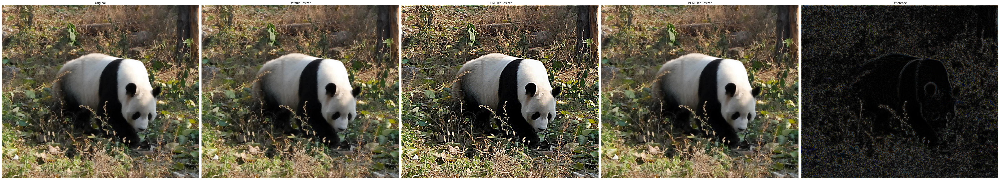

In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision import transforms
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
import tensorflow as tf


torch.set_default_dtype(torch.float32)

torch.manual_seed(0)
class MullerResizerTorch(nn.Module):
    def __init__(self, target_size=(224, 224), base_resize_method='bilinear', kernel_size=5, stddev=1.0, num_layers=2, avg_pool=False, init_weights=None, dtype=torch.float32):
        super(MullerResizerTorch, self).__init__()
        self.target_size = target_size
        self.kernel_size = kernel_size
        self.stddev = stddev
        self.num_layers = num_layers
        self.avg_pool = avg_pool
        self.dtype = dtype

        interpolation_methods = {
            'bilinear': 'bilinear',
            'nearest': 'nearest',
            'bicubic': 'bicubic'
        }
        self.interpolation_method = interpolation_methods.get(base_resize_method, 'bilinear')

        self.weights = nn.ParameterList()
        self.biases = nn.ParameterList()
        if init_weights is not None:
            for i in range(num_layers):
                self.weights.append(nn.Parameter(torch.tensor(init_weights[2 * i], dtype=dtype)))
                self.biases.append(nn.Parameter(torch.tensor(init_weights[2 * i + 1], dtype=dtype)))
        else:
            for _ in range(num_layers):
                self.weights.append(nn.Parameter(torch.zeros((), dtype=dtype)))
                self.biases.append(nn.Parameter(torch.zeros((), dtype=dtype)))

        self.gaussian_kernel = self.create_gaussian_kernel(kernel_size, stddev)

    def create_gaussian_kernel(self, kernel_size, stddev):
        t = torch.arange(kernel_size, dtype=self.dtype) - (kernel_size - 1) / 2
        gaussian_kernel = torch.exp(-t.pow(2) / (2 * stddev**2))
        gaussian_kernel /= gaussian_kernel.sum()
        gaussian_kernel = gaussian_kernel.view(1, 1, kernel_size, 1) * gaussian_kernel.view(1, 1, 1, kernel_size)
        gaussian_kernel = gaussian_kernel.repeat(3, 1, 1, 1)
        return gaussian_kernel

    def _apply_gaussian_blur(self, x):
        padding = self.kernel_size // 2
        x = F.pad(x, (padding, padding, padding, padding), mode='reflect')
        return F.conv2d(x, self.gaussian_kernel, groups=3)

    def forward(self, x):
        x = x.to(dtype=self.dtype)
        if self.avg_pool:
            x = F.avg_pool2d(x, kernel_size=2, stride=2)
        net = F.interpolate(x, size=self.target_size, mode=self.interpolation_method, align_corners=False)
        
        for weight, bias in zip(self.weights, self.biases):
            blurred = self._apply_gaussian_blur(x)
            residual = blurred - x
            resized_residual = F.interpolate(residual, size=self.target_size, mode=self.interpolation_method, align_corners=False)
            net = net + torch.tanh(weight * resized_residual + bias)
            x = blurred

        return net

class MullerResizerTF(tf.keras.layers.Layer):
    def __init__(self, target_size=(224, 224), base_resize_method=tf.image.ResizeMethod.BILINEAR, antialias=False, kernel_size=5, stddev=1.0, num_layers=2, avg_pool=False, dtype=tf.float32, init_weights=None):
        super().__init__()
        self._target_size = target_size
        self._base_resize_method = base_resize_method
        self._antialias = antialias
        self._kernel_size = kernel_size
        self._stddev = stddev
        self._num_layers = num_layers
        self._avg_pool = avg_pool
        self._dtype = dtype
        self._init_weights = init_weights

    def build(self, input_shape):
        self._weights = []
        self._biases = []
        for layer in range(1, self._num_layers + 1):
            weight = self.add_weight(name='weight_' + str(layer), shape=[], dtype=self._dtype, initializer=tf.keras.initializers.Constant(self._init_weights[2*layer-2]) if self._init_weights else tf.keras.initializers.zeros())
            bias = self.add_weight(name='bias_' + str(layer), shape=[], dtype=self._dtype, initializer=tf.keras.initializers.Constant(self._init_weights[2*layer-1]) if self._init_weights else tf.keras.initializers.zeros())
            self._weights.append(weight)
            self._biases.append(bias)

    def _base_resizer(self, inputs):
        stride = [1, inputs.get_shape().as_list()[1] // self._target_size[0], inputs.get_shape().as_list()[2] // self._target_size[1], 1]
        if self._avg_pool and stride[1] > 1 and stride[2] > 1:
            pooling_shape = [1, stride[1], stride[2], 1]
            inputs = tf.nn.avg_pool(inputs, pooling_shape, stride, padding='SAME')
        return tf.cast(tf.image.resize(inputs, self._target_size, method=self._base_resize_method, antialias=self._antialias), self._dtype)

    def _gaussian_blur(self, inputs):
        stddev = tf.cast(self._stddev, self._dtype)
        size = self._kernel_size
        radius = size // 2
        x = tf.cast(tf.range(-radius, radius + 1), self._dtype)
        blur_filter = tf.exp(-tf.pow(x, 2.0) / (2.0 * tf.pow(stddev, 2.0)))
        blur_filter /= tf.reduce_sum(blur_filter)
        blur_v = tf.reshape(blur_filter, [size, 1, 1, 1])
        blur_h = tf.reshape(blur_filter, [1, size, 1, 1])
        num_channels = inputs.get_shape()[-1]
        blur_h = tf.tile(blur_h, [1, 1, num_channels, 1])
        blur_v = tf.tile(blur_v, [1, 1, num_channels, 1])
        blurred = tf.nn.depthwise_conv2d(inputs, blur_h, strides=[1, 1, 1, 1], padding='SAME')
        blurred = tf.nn.depthwise_conv2d(blurred, blur_v, strides=[1, 1, 1, 1], padding='SAME')
        return blurred

    def call(self, inputs):
        inputs.get_shape().assert_has_rank(4)
        if inputs.dtype != self._dtype:
            inputs = tf.cast(inputs, self._dtype)
        net = self._base_resizer(inputs)
        for weight, bias in zip(self._weights, self._biases):
            blurred = self._gaussian_blur(inputs)
            residual_image = blurred - inputs
            resized_residual = self._base_resizer(residual_image)
            net = net + tf.nn.tanh(weight * resized_residual + bias)
            inputs = blurred
        return net

image_path = '/home/ozkan/works/n-smoe/notebooks/panda.jpg'
image = Image.open(image_path).convert('RGB')
transform = transforms.ToTensor()
tensor = transform(image).unsqueeze(0)

def default_resizer(inputs, target_size):
    return F.interpolate(inputs, size=target_size, mode='bilinear', align_corners=False, antialias=True)

output_default = default_resizer(tensor, target_size=(tensor.size(2), tensor.size(3)))

resizer_torch = MullerResizerTorch(target_size=(tensor.size(2), tensor.size(3)),base_resize_method ='bilinear',  kernel_size=5, 
                                   stddev=1.0, num_layers=2, avg_pool=False, dtype=torch.float32, 
                                   init_weights=[1.9280042333186972, -91.42857142857143, 9.99854848098652489, 333.3333333333333]*5)

if tensor.dim() == 3:
    tensor = tensor.unsqueeze(0)

resizer_torch = resizer_torch.eval()
with torch.no_grad():
    output_torch = resizer_torch(tensor)

_CONFIGS = {
    "target_size": (image.height, image.width),
    "base_resize_method": tf.image.ResizeMethod.BILINEAR,
    "antialias": False,
    "kernel_size": 5,
    "stddev": 1.0,
    "num_layers": 2,
    "avg_pool": False,
    "dtype": tf.float32,
    "init_weights": [1.892, -0.014, -11.295, 0.003]
}

model_tf = MullerResizerTF(**_CONFIGS)

def inference_tf(image_path, model):
    image = Image.open(image_path).convert("RGB")
    image = np.asarray(image) / 255.
    image = tf.expand_dims(image, axis=0)
    preds = model(image)
    preds = np.array(preds[0], np.float32)
    return np.array(np.clip(preds, 0.0, 1.0))

output_image_tf = inference_tf(image_path, model_tf)

output_default = transforms.ToPILImage()(output_default.squeeze(0))
output_image_tf = transforms.ToPILImage()(output_image_tf)
output_image_torch = transforms.ToPILImage()(output_torch.squeeze(0))

output_tf_np = np.array(output_image_tf).astype(np.float32) / 255.0
output_torch_np = np.array(output_image_torch).astype(np.float32) / 255.0
difference = np.abs(output_tf_np - output_torch_np)

fig, axes = plt.subplots(nrows=1, ncols=5, figsize=(60, 20))

axes[0].imshow(image)
axes[0].set_title('Original')
axes[0].axis('off')

axes[1].imshow(output_default)
axes[1].set_title('Default Resizer')
axes[1].axis('off')

axes[2].imshow(output_image_tf)
axes[2].set_title('TF Muller Resizer')
axes[2].axis('off')

axes[3].imshow(output_image_torch)
axes[3].set_title('PT Muller Resizer')
axes[3].axis('off')

axes[4].imshow(difference) 
axes[4].set_title('Difference')
axes[4].axis('off')

plt.tight_layout()
plt.show()

In [ ]:
import numpy as np
import tensorflow as tf
import torch
import torch.nn.functional as F
from sklearn.metrics import mean_squared_error

# Generate the same random image
np.random.seed(42)
random_image = np.random.rand(256, 256, 3).astype(np.float32)

# TensorFlow resizing
def resize_tf(image):
    tf_image = tf.convert_to_tensor(image)
    tf_resized_image = tf.image.resize(tf_image, [128, 128], method='bilinear')
    return tf_resized_image.numpy()

# PyTorch resizing using torch.nn.functional.interpolate
def resize_pytorch(image):
    image_tensor = torch.tensor(image.transpose(2, 0, 1)).unsqueeze(0)
    resized_image_tensor = F.interpolate(image_tensor, size=(128, 128), mode='bilinear', align_corners=False)
    resized_image_np = resized_image_tensor.squeeze(0).numpy().transpose(1, 2, 0)
    return resized_image_np

# Perform resizing
resized_image_tf = resize_tf(random_image)
resized_image_pytorch = resize_pytorch(random_image)

# Compare the results using Mean Squared Error (MSE)
mse = mean_squared_error(resized_image_tf.flatten(), resized_image_pytorch.flatten())

print(f"Mean Squared Error between TensorFlow and PyTorch resized images: {mse}")

In [ ]:
import tensorflow as tf
import torch
import torch.nn as nn
import numpy as np

# TensorFlow setup
input_channels = 3
kernel_size = 3
input_tensor_tf = tf.random.normal([1, 32, 32, input_channels])
depthwise_conv_tf = tf.keras.layers.DepthwiseConv2D(kernel_size=kernel_size, padding='same')
depthwise_conv_tf.build(input_tensor_tf.shape)
depthwise_kernel_tf = tf.random.normal(depthwise_conv_tf.weights[0].shape)
depthwise_conv_tf.set_weights([depthwise_kernel_tf, tf.zeros(depthwise_conv_tf.weights[1].shape)])

# PyTorch setup
depthwise_conv_pt = nn.Conv2d(in_channels=input_channels,
                              out_channels=input_channels,
                              kernel_size=kernel_size,
                              padding='same',
                              groups=input_channels)

# Ensure same initialization
with torch.no_grad():
    depthwise_conv_pt.weight.copy_(torch.tensor(depthwise_kernel_tf.numpy().transpose(2, 3, 0, 1)))
    depthwise_conv_pt.bias.copy_(torch.zeros(depthwise_conv_pt.bias.shape))

input_tensor_pt = torch.tensor(input_tensor_tf.numpy().transpose(0, 3, 1, 2))

# Apply convolutions
output_tensor_tf = depthwise_conv_tf(input_tensor_tf)
output_tensor_pt = depthwise_conv_pt(input_tensor_pt)

# Convert outputs to numpy arrays
output_tensor_pt_np = output_tensor_pt.detach().numpy().transpose(0, 2, 3, 1)
output_tensor_tf_np = output_tensor_tf.numpy()

# Calculate and print MSE
mse = np.mean((output_tensor_tf_np - output_tensor_pt_np) ** 2)
print("Mean Squared Error between TensorFlow and PyTorch outputs:", mse)


In [ ]:
import numpy as np
import cv2

def generate_complexity_map(image):
    # Example using Sobel operator to estimate edge density
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=5)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=5)
    magnitude = np.sqrt(sobelx**2 + sobely**2)
    return cv2.normalize(magnitude, None, 0, 1, norm_type=cv2.NORM_MINMAX)

def adaptive_patch_extraction(image, complexity_map, min_size=32, max_size=128):
    height, width = image.shape[:2]
    patches = []
    i = 0
    while i < height:
        j = 0
        while j < width:
            complexity = complexity_map[i, j]
            # Determine patch size by complexity: smaller patch for higher complexity
            patch_size = int(max_size - (complexity * (max_size - min_size)))
            patch_size = min(patch_size, height - i, width - j)  # Adjust if near borders

            # Extract patch
            patch = image[i:i+patch_size, j:j+patch_size]
            patches.append(patch)

            # Calculate overlap
            overlap = int(0.2 * patch_size)  # Example: 20% overlap
            j += patch_size - overlap
        i += patch_size - overlap

    return patches
image_path = '/home/ozkan/works/n-smoe/notebooks/panda.jpg'

image = cv2.imread(image_path)
complexity_map = generate_complexity_map(image)
patches = adaptive_patch_extraction(image, complexity_map)


In [ ]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

def generate_complexity_map(image):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=5)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=5)
    magnitude = np.sqrt(sobelx**2 + sobely**2)
    return cv2.normalize(magnitude, None, 0, 1, norm_type=cv2.NORM_MINMAX)

def adaptive_patch_extraction(image, complexity_map, min_size=32, max_size=128):
    height, width = image.shape[:2]
    patches = []
    i = 0
    plt.figure(figsize=(12, 8))
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))  # Show the original image
    plt.title('Adaptive Patch Extraction')
    ax = plt.gca()

    while i < height:
        j = 0
        while j < width:
            complexity = complexity_map[i, j]
            patch_size = int(max_size - (complexity * (max_size - min_size)))
            patch_size = min(patch_size, height - i, width - j)

            # Draw rectangle around the patch
            rect = plt.Rectangle((j, i), patch_size, patch_size, edgecolor='red', facecolor='none')
            ax.add_patch(rect)

            patch = image[i:i+patch_size, j:j+patch_size]
            patches.append(patch)

            overlap = int(0.2 * patch_size)  # 20% overlap
            j += patch_size - overlap
        i += patch_size - overlap

    plt.axis('off')
    plt.show()
    return patches

# Load and process the image
image_path = '/home/ozkan/works/n-smoe/notebooks/panda.jpg'
image = cv2.imread(image_path)
complexity_map = generate_complexity_map(image)
patches = adaptive_patch_extraction(image, complexity_map)

# Optionally, show the complexity map and some patches
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(complexity_map, cmap='gray')
plt.title('Complexity Map')
plt.axis('off')

# Display first few patches
plt.subplot(1, 2, 2)
for n, patch in enumerate(patches[:4]):  # Show the first 4 patches
    plt.subplot(2, 2, n+1)
    plt.imshow(cv2.cvtColor(patch, cv2.COLOR_BGR2RGB))
    plt.title(f'Patch {n+1}')
    plt.axis('off')
plt.tight_layout()
plt.show()


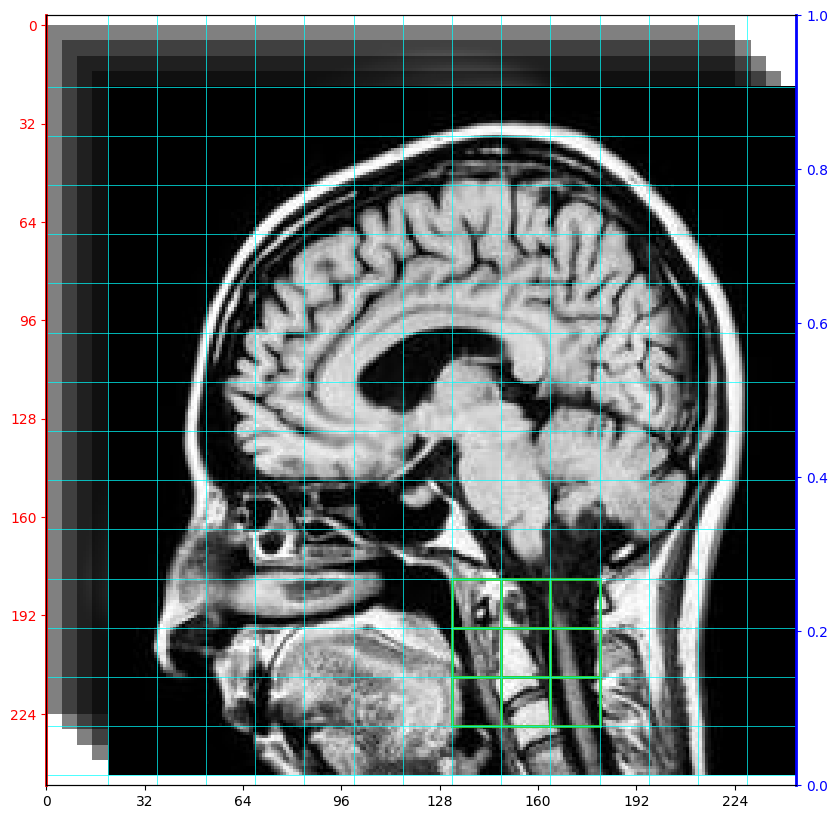

In [1]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import cv2
import numpy as np
from PIL import Image

image_path = "/mnt/e/Medical/mri/data_for_train/brain2/no_tumor/image(145).jpg"
image = Image.open(image_path)
image = cv2.cvtColor(np.array(image), cv2.COLOR_BGR2GRAY)

height, width = image.shape
block_size = 16

num_blocks_x = width // block_size
num_blocks_y = height // block_size

adjusted_width = num_blocks_x * block_size
adjusted_height = num_blocks_y * block_size
image = image[:adjusted_height, :adjusted_width]

fig, ax = plt.subplots(figsize=(10, 10))

num_layers = 4
offset = 5

for i in range(num_layers):
    blurred_image = cv2.GaussianBlur(image, (11, 11), 5 + 2 * i)
    ax.imshow(blurred_image, cmap='gray', alpha=0.5, extent=(i * offset, adjusted_width + i * offset, adjusted_height + i * offset, i * offset))

ax.imshow(image, cmap='gray', alpha=1.0, extent=(num_layers * offset, adjusted_width + num_layers * offset, adjusted_height + num_layers * offset, num_layers * offset))

border_color = 'cyan'
highlight_color = 'limegreen'
for i in range(0, adjusted_width + 1, block_size):
    ax.axvline(i + num_layers * offset, color=border_color, linewidth=0.5)
for j in range(0, adjusted_height + 1, block_size):
    ax.axhline(j + num_layers * offset, color=border_color, linewidth=0.5)

cerebellum_x_start = (num_blocks_x // 2) * block_size + num_layers * offset
cerebellum_x_end = cerebellum_x_start + 3 * block_size
cerebellum_y_start = (num_blocks_y - 4) * block_size + num_layers * offset
cerebellum_y_end = cerebellum_y_start + 3 * block_size

for i in range(cerebellum_x_start, cerebellum_x_end, block_size):
    for j in range(cerebellum_y_start, cerebellum_y_end, block_size):
        rect = patches.Rectangle((i, j), block_size, block_size, linewidth=2, edgecolor=highlight_color, facecolor='none')
        ax.add_patch(rect)

fig.subplots_adjust(left=0.15)

ax.spines['left'].set_color('red')
ax.spines['left'].set_linewidth(2)
ax.yaxis.label.set_color('red')
ax.tick_params(axis='y', colors='red')

ax2 = ax.twinx()
ax2.spines['right'].set_color('blue')
ax2.spines['right'].set_linewidth(2)
ax2.yaxis.label.set_color('blue')
ax2.tick_params(axis='y', colors='blue')

ax.set_xticks(np.arange(0, adjusted_width + 1, block_size * 2))
ax.set_xticklabels(np.arange(0, adjusted_width + 1, block_size * 2))
ax.set_yticks(np.arange(0, adjusted_height + 1, block_size * 2))
ax.set_yticklabels(np.arange(0, adjusted_height + 1, block_size * 2))

plt.grid(False)
plt.show()

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision import transforms
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
import tensorflow as tf
import matlab.engine

torch.set_default_dtype(torch.float32)
torch.manual_seed(0)

class MullerResizerTorch(nn.Module):
    def __init__(self, target_size=(224, 224), base_resize_method='bilinear', kernel_size=5, stddev=1.0, num_layers=2, avg_pool=False, init_weights=None, dtype=torch.float32):
        super(MullerResizerTorch, self).__init__()
        self.target_size = target_size
        self.kernel_size = kernel_size
        self.stddev = stddev
        self.num_layers = num_layers
        self.avg_pool = avg_pool
        self.dtype = dtype

        interpolation_methods = {
            'bilinear': 'bilinear',
            'nearest': 'nearest',
            'bicubic': 'bicubic'
        }
        self.interpolation_method = interpolation_methods.get(base_resize_method, 'bilinear')

        self.weights = nn.ParameterList()
        self.biases = nn.ParameterList()
        if init_weights is not None:
            for i in range(num_layers):
                self.weights.append(nn.Parameter(torch.tensor(init_weights[2 * i], dtype=dtype)))
                self.biases.append(nn.Parameter(torch.tensor(init_weights[2 * i + 1], dtype=dtype)))
        else:
            for _ in range(num_layers):
                self.weights.append(nn.Parameter(torch.zeros((), dtype=dtype)))
                self.biases.append(nn.Parameter(torch.zeros((), dtype=dtype)))

        self.gaussian_kernel = self.create_gaussian_kernel(kernel_size, stddev)

    def create_gaussian_kernel(self, kernel_size, stddev):
        t = torch.arange(kernel_size, dtype=self.dtype) - (kernel_size - 1) / 2
        gaussian_kernel = torch.exp(-t.pow(2) / (2 * stddev**2))
        gaussian_kernel /= gaussian_kernel.sum()
        gaussian_kernel = gaussian_kernel.view(1, 1, kernel_size, 1) * gaussian_kernel.view(1, 1, 1, kernel_size)
        gaussian_kernel = gaussian_kernel.repeat(3, 1, 1, 1)
        return gaussian_kernel

    def _apply_gaussian_blur(self, x):
        padding = self.kernel_size // 2
        x = F.pad(x, (padding, padding, padding, padding), mode='reflect')
        return F.conv2d(x, self.gaussian_kernel, groups=3)

    def forward(self, x):
        x = x.to(dtype=self.dtype)
        if self.avg_pool:
            x = F.avg_pool2d(x, kernel_size=2, stride=2)
        net = F.interpolate(x, size=self.target_size, mode=self.interpolation_method, align_corners=False)
        
        for weight, bias in zip(self.weights, self.biases):
            blurred = self._apply_gaussian_blur(x)
            residual = blurred - x
            resized_residual = F.interpolate(residual, size=self.target_size, mode=self.interpolation_method, align_corners=False)
            net = net + torch.tanh(weight * resized_residual + bias)
            x = blurred

        return net

class MullerResizerTF(tf.keras.layers.Layer):
    def __init__(self, target_size=(224, 224), base_resize_method=tf.image.ResizeMethod.BILINEAR, antialias=False, kernel_size=5, stddev=1.0, num_layers=2, avg_pool=False, dtype=tf.float32, init_weights=None):
        super().__init__()
        self._target_size = target_size
        self._base_resize_method = base_resize_method
        self._antialias = antialias
        self._kernel_size = kernel_size
        self._stddev = stddev
        self._num_layers = num_layers
        self._avg_pool = avg_pool
        self._dtype = dtype
        self._init_weights = init_weights

    def build(self, input_shape):
        self._weights = []
        self._biases = []
        for layer in range(1, self._num_layers + 1):
            weight = self.add_weight(name='weight_' + str(layer), shape=[], dtype=self._dtype, initializer=tf.keras.initializers.Constant(self._init_weights[2*layer-2]) if self._init_weights else tf.keras.initializers.zeros())
            bias = self.add_weight(name='bias_' + str(layer), shape=[], dtype=self._dtype, initializer=tf.keras.initializers.Constant(self._init_weights[2*layer-1]) if self._init_weights else tf.keras.initializers.zeros())
            self._weights.append(weight)
            self._biases.append(bias)

    def _base_resizer(self, inputs):
        stride = [1, inputs.get_shape().as_list()[1] // self._target_size[0], inputs.get_shape().as_list()[2] // self._target_size[1], 1]
        if self._avg_pool and stride[1] > 1 and stride[2] > 1:
            pooling_shape = [1, stride[1], stride[2], 1]
            inputs = tf.nn.avg_pool(inputs, pooling_shape, stride, padding='SAME')
        return tf.cast(tf.image.resize(inputs, self._target_size, method=self._base_resize_method, antialias=self._antialias), self._dtype)

    def _gaussian_blur(self, inputs):
        stddev = tf.cast(self._stddev, self._dtype)
        size = self._kernel_size
        radius = size // 2
        x = tf.cast(tf.range(-radius, radius + 1), self._dtype)
        blur_filter = tf.exp(-tf.pow(x, 2.0) / (2.0 * tf.pow(stddev, 2.0)))
        blur_filter /= tf.reduce_sum(blur_filter)
        blur_v = tf.reshape(blur_filter, [size, 1, 1, 1])
        blur_h = tf.reshape(blur_filter, [1, size, 1, 1])
        num_channels = inputs.get_shape()[-1]
        blur_h = tf.tile(blur_h, [1, 1, num_channels, 1])
        blur_v = tf.tile(blur_v, [1, 1, num_channels, 1])
        blurred = tf.nn.depthwise_conv2d(inputs, blur_h, strides=[1, 1, 1, 1], padding='SAME')
        blurred = tf.nn.depthwise_conv2d(blurred, blur_v, strides=[1, 1, 1, 1], padding='SAME')
        return blurred

    def call(self, inputs):
        inputs.get_shape().assert_has_rank(4)
        if inputs.dtype != self._dtype:
            inputs = tf.cast(inputs, self._dtype)
        net = self._base_resizer(inputs)
        for weight, bias in zip(self._weights, self._biases):
            blurred = self._gaussian_blur(inputs)
            residual_image = blurred - inputs
            resized_residual = self._base_resizer(residual_image)
            net = net + tf.nn.tanh(weight * resized_residual + bias)
            inputs = blurred
        return net

image_path = '/home/ozkan/works/n-smoe/notebooks/panda.jpg'
image = Image.open(image_path).convert('RGB')
transform = transforms.ToTensor()
tensor = transform(image).unsqueeze(0)

def default_resizer(inputs, target_size):
    return F.interpolate(inputs, size=target_size, mode='bilinear', align_corners=False, antialias=True)

output_default = default_resizer(tensor, target_size=(tensor.size(2), tensor.size(3)))

resizer_torch = MullerResizerTorch(target_size=(tensor.size(2), tensor.size(3)), base_resize_method='bilinear',
                                   kernel_size=5, stddev=1.0, num_layers=2, avg_pool=False, dtype=torch.float32,
                                   init_weights=[1.9280042333186972, -91.42857142857143, 9.99854848098652489, 333.3333333333333] * 5)

if tensor.dim() == 3:
    tensor = tensor.unsqueeze(0)

resizer_torch = resizer_torch.eval()
with torch.no_grad():
    output_torch = resizer_torch(tensor)

_CONFIGS = {
    "target_size": (image.height, image.width),
    "base_resize_method": tf.image.ResizeMethod.BILINEAR,
    "antialias": False,
    "kernel_size": 5,
    "stddev": 1.0,
    "num_layers": 2,
    "avg_pool": False,
    "dtype": tf.float32,
    "init_weights": [1.892, -0.014, -11.295, 0.003]
}

model_tf = MullerResizerTF(**_CONFIGS)

def inference_tf(image_path, model):
    image = Image.open(image_path).convert("RGB")
    image = np.asarray(image) / 255.
    image = tf.expand_dims(image, axis=0)
    preds = model(image)
    preds = np.array(preds[0], np.float32)
    return np.array(np.clip(preds, 0.0, 1.0))

output_image_tf = inference_tf(image_path, model_tf)

output_default = transforms.ToPILImage()(output_default.squeeze(0))
output_image_tf = transforms.ToPILImage()(output_image_tf)
output_image_torch = transforms.ToPILImage()(output_torch.squeeze(0))

output_tf_np = np.array(output_image_tf).astype(np.float32) / 255.0
output_torch_np = np.array(output_image_torch).astype(np.float32) / 255.0
original_np = np.array(image).astype(np.float32) / 255.0
difference = np.abs(output_tf_np - output_torch_np)


eng = matlab.engine.start_matlab()

original_image_mat = eng.uint8(original_np * 255)
output_image_tf_mat = eng.uint8(output_tf_np * 255)
output_image_torch_mat = eng.uint8(output_torch_np * 255)


mse_tf = eng.immse(original_image_mat, output_image_tf_mat)
psnr_tf = eng.psnr(original_image_mat, output_image_tf_mat)
ssim_tf = eng.ssim(original_image_mat, output_image_tf_mat)

mse_torch = eng.immse(original_image_mat, output_image_torch_mat)
psnr_torch = eng.psnr(original_image_mat, output_image_torch_mat)
ssim_torch = eng.ssim(original_image_mat, output_image_torch_mat)

print(f"TF Resizer - MSE: {mse_tf}, PSNR: {psnr_tf}, SSIM: {ssim_tf}")
print(f"PT Resizer - MSE: {mse_torch}, PSNR: {psnr_torch}, SSIM: {ssim_torch}")

eng.quit()

fig, axes = plt.subplots(nrows=1, ncols=5, figsize=(60, 20))

axes[0].imshow(image)
axes[0].set_title('Original')
axes[0].axis('off')

axes[1].imshow(output_default)
axes[1].set_title('Default Resizer')
axes[1].axis('off')

axes[2].imshow(output_image_tf)
axes[2].set_title('TF Muller Resizer')
axes[2].axis('off')

axes[3].imshow(output_image_torch)
axes[3].set_title('PT Muller Resizer')
axes[3].axis('off')

axes[4].imshow(difference) 
axes[4].set_title('Difference')
axes[4].axis('off')

plt.tight_layout()
plt.show()


In [ ]:
import matlab.engine

image_path = '/home/ozkan/works/n-smoe/notebooks/panda.jpg'
eng = matlab.engine.start_matlab()

rgb = eng.imread(image_path)
I = eng.im2gray(rgb)
eng.imshow(I)

eng.text(732,501,"Image courtesy of Corel(R)",
     "FontSize",7,"HorizontalAlignment","right")

gmag = eng.imgradient(I)
eng.imshow(gmag,[])
eng.title("Gradient Magnitude")


L = eng.watershed(gmag)
Lrgb = eng.label2rgb(L)
eng.imshow(Lrgb)
eng.title("Watershed Transform of Gradient Magnitude")

se = eng.strel("disk",eng.double(20))
Io = eng.imopen(I,se)
eng.imshow(Io)
eng.title("Opening")


Ie = eng.imerode(I,se)
Iobr = eng.imreconstruct(Ie,I)
eng.imshow(Iobr)
eng.title("Opening-by-Reconstruction")


Ioc = eng.imclose(Io,se)
eng.imshow(Ioc)
eng.title("Opening-Closing")


Iobrd = eng.imdilate(Iobr,se)
Iobrcbr = eng.imreconstruct(eng.imcomplement(Iobrd),eng.imcomplement(Iobr))
Iobrcbr = eng.imcomplement(Iobrcbr)
eng.imshow(Iobrcbr)
eng.title("Opening-Closing by Reconstruction")


fgm = eng.imregionalmax(Iobrcbr)
eng.imshow(fgm)
eng.title("Regional Maxima of Opening-Closing by Reconstruction")

I2 = eng.labeloverlay(I,fgm)
eng.imshow(I2)
eng.title("Regional Maxima Superimposed on Original Image")

se2 = eng.strel(eng.ones(5,5))
fgm2 = eng.imclose(fgm,se2)
fgm3 = eng.imerode(fgm2,se2)

fgm4 = eng.bwareaopen(fgm3,eng.double(20))
I3 = eng.labeloverlay(I,fgm4)
eng.imshow(I3)
eng.title("Modified Regional Maxima Superimposed on Original Image")

bw = eng.imbinarize(Iobrcbr)
eng.imshow(bw)
eng.title("Thresholded Opening-Closing by Reconstruction")


D = eng.bwdist(bw)
DL = eng.watershed(D)
bgm = DL == 0
eng.imshow(bgm)
eng.title("Watershed Ridge Lines")


bgm_logical = eng.logical(bgm)
fgm4_logical = eng.logical(fgm4)

mask = eng.bitor(bgm_logical, fgm4_logical, nargout=1)

gmag2 = eng.imimposemin(gmag, mask)
L = eng.watershed(gmag2)


In [ ]:
numColors = 2
# L = eng.imsegkmeans(I,numColors)
# B = eng.labeloverlay(I,L)
# eng.imshow(B)
# eng.title("Labeled Image RGB")

lab_I = eng.rgb2lab(rgb)

type(lab_I)


ab = eng.zeros(lab_I.size[0], lab_I.size[1], 2, 'like', lab_I)
ab[:,:,0] = lab_I[:,:,1]  # MATLAB indexing for 'a' channel
ab[:,:,1] = lab_I[:,:,2]  # MATLAB indexing for 'b' channel


ab_single = eng.im2single(ab)


numColors = 3  # Define the number of colors for k-means
pixel_labels = eng.imsegkmeans(ab_single, numColors, 'NumAttempts', 3)

eng.imshow(pixel_labels)
eng.title("Segmentation Result")


# ab = lab_I(:,:,2:3)
# ab = eng.im2single(ab)
# pixel_labels = eng.imsegkmeans(ab,numColors,NumAttempts=3)

In [ ]:
from cuml.cluster import KMeans
from sklearn import datasets
import numpy as np
X, y = datasets.make_moons(n_samples=1000, noise=0.12)
import matplotlib.pyplot as plt
plt.scatter(X[:,0], X[:,1], c=y, s=0.5)

In [ ]:
kmeans_labels_ = KMeans(n_clusters=2).fit_predict(X)

In [ ]:
plt.title("Interleaved Moons w/ K-Means")
plt.xticks([])
plt.yticks([])
plt.scatter(X[:,0], X[:,1], c=kmeans_labels_, s=1.0)

In [ ]:
from cuml.cluster import DBSCAN
dbscan_labels_ = DBSCAN().fit_predict(X)

In [ ]:
plt.scatter(X[:,0], X[:,1], c=dbscan_labels_, s=1.0)

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision import transforms
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
import tensorflow as tf
import cudf
from cuml.cluster import DBSCAN  # Use DBSCAN from cuml.cluster
import matplotlib.colors as mcolors
import logging

# Configure logging
logging.basicConfig(level=logging.INFO)

torch.set_default_dtype(torch.float32)
torch.manual_seed(0)

class MullerResizerTorch(nn.Module):
    def __init__(self, target_size=(224, 224), base_resize_method='bilinear', kernel_size=5, stddev=1.0, num_layers=2, avg_pool=False, init_weights=None, dtype=torch.float32):
        super(MullerResizerTorch, self).__init__()
        self.target_size = target_size
        self.kernel_size = kernel_size
        self.stddev = stddev
        self.num_layers = num_layers
        self.avg_pool = avg_pool
        self.dtype = dtype

        interpolation_methods = {
            'bilinear': 'bilinear',
            'nearest': 'nearest',
            'bicubic': 'bicubic'
        }
        self.interpolation_method = interpolation_methods.get(base_resize_method, 'bilinear')

        self.weights = nn.ParameterList()
        self.biases = nn.ParameterList()
        if init_weights is not None:
            for i in range(num_layers):
                self.weights.append(nn.Parameter(torch.tensor(init_weights[2 * i], dtype=dtype)))
                self.biases.append(nn.Parameter(torch.tensor(init_weights[2 * i + 1], dtype=dtype)))
        else:
            for _ in range(num_layers):
                self.weights.append(nn.Parameter(torch.zeros((), dtype=dtype)))
                self.biases.append(nn.Parameter(torch.zeros((), dtype=dtype)))

        self.gaussian_kernel = self.create_gaussian_kernel(kernel_size, stddev)

    def create_gaussian_kernel(self, kernel_size, stddev):
        t = torch.arange(kernel_size, dtype=self.dtype) - (kernel_size - 1) / 2
        gaussian_kernel = torch.exp(-t.pow(2) / (2 * stddev**2))
        gaussian_kernel /= gaussian_kernel.sum()
        gaussian_kernel = gaussian_kernel.view(1, 1, kernel_size, 1) * gaussian_kernel.view(1, 1, 1, kernel_size)
        gaussian_kernel = gaussian_kernel.repeat(3, 1, 1, 1)
        return gaussian_kernel

    def _apply_gaussian_blur(self, x):
        padding = self.kernel_size // 2
        x = F.pad(x, (padding, padding, padding, padding), mode='reflect')
        return F.conv2d(x, self.gaussian_kernel, groups=3)

    def forward(self, x):
        x = x.to(dtype=self.dtype)
        if self.avg_pool:
            x = F.avg_pool2d(x, kernel_size=2, stride=2)
        net = F.interpolate(x, size=self.target_size, mode=self.interpolation_method, align_corners=False)
        
        for weight, bias in zip(self.weights, self.biases):
            blurred = self._apply_gaussian_blur(x)
            residual = blurred - x
            resized_residual = F.interpolate(residual, size=self.target_size, mode=self.interpolation_method, align_corners=False)
            net = net + torch.tanh(weight * resized_residual + bias)
            x = blurred

        return net

class MullerResizerTF(tf.keras.layers.Layer):
    def __init__(self, target_size=(224, 224), base_resize_method=tf.image.ResizeMethod.BILINEAR, antialias=False, kernel_size=5, stddev=1.0, num_layers=2, avg_pool=False, dtype=tf.float32, init_weights=None):
        super().__init__()
        self._target_size = target_size
        self._base_resize_method = base_resize_method
        self._antialias = antialias
        self._kernel_size = kernel_size
        self._stddev = stddev
        self._num_layers = num_layers
        self._avg_pool = avg_pool
        self._dtype = dtype
        self._init_weights = init_weights

    def build(self, input_shape):
        self._weights = []
        self._biases = []
        for layer in range(1, self._num_layers + 1):
            weight = self.add_weight(name='weight_' + str(layer), shape=[], dtype=self._dtype, initializer=tf.keras.initializers.Constant(self._init_weights[2*layer-2]) if self._init_weights else tf.keras.initializers.zeros())
            bias = self.add_weight(name='bias_' + str(layer), shape=[], dtype=self._dtype, initializer=tf.keras.initializers.Constant(self._init_weights[2*layer-1]) if self._init_weights else tf.keras.initializers.zeros())
            self._weights.append(weight)
            self._biases.append(bias)

    def _base_resizer(self, inputs):
        stride = [1, inputs.get_shape().as_list()[1] // self._target_size[0], inputs.get_shape().as_list()[2] // self._target_size[1], 1]
        if self._avg_pool and stride[1] > 1 and stride[2] > 1:
            pooling_shape = [1, stride[1], stride[2], 1]
            inputs = tf.nn.avg_pool(inputs, pooling_shape, stride, padding='SAME')
        return tf.cast(tf.image.resize(inputs, self._target_size, method=self._base_resize_method, antialias=self._antialias), self._dtype)

    def _gaussian_blur(self, inputs):
        stddev = tf.cast(self._stddev, self._dtype)
        size = self._kernel_size
        radius = size // 2
        x = tf.cast(tf.range(-radius, radius + 1), self._dtype)
        blur_filter = tf.exp(-tf.pow(x, 2.0) / (2.0 * tf.pow(stddev, 2.0)))
        blur_filter /= tf.reduce_sum(blur_filter)
        blur_v = tf.reshape(blur_filter, [size, 1, 1, 1])
        blur_h = tf.reshape(blur_filter, [1, size, 1, 1])
        num_channels = inputs.get_shape()[-1]
        blur_h = tf.tile(blur_h, [1, 1, num_channels, 1])
        blur_v = tf.tile(blur_v, [1, 1, num_channels, 1])
        blurred = tf.nn.depthwise_conv2d(inputs, blur_h, strides=[1, 1, 1, 1], padding='SAME')
        blurred = tf.nn.depthwise_conv2d(blurred, blur_v, strides=[1, 1, 1, 1], padding='SAME')
        return blurred

    def call(self, inputs):
        inputs.get_shape().assert_has_rank(4)
        if inputs.dtype != self._dtype:
            inputs = tf.cast(inputs, self._dtype)
        net = self._base_resizer(inputs)
        for weight, bias in zip(self._weights, self._biases):
            blurred = self._gaussian_blur(inputs)
            residual_image = blurred - inputs
            resized_residual = self._base_resizer(residual_image)
            net = net + tf.nn.tanh(weight * resized_residual + bias)
            inputs = blurred
        return net

def extract_features(image):
    return image.reshape(-1, 1)

def apply_dbscan(features, eps=5, min_samples=5):  # Use DBSCAN from cuml.cluster
    gdf = cudf.DataFrame(features)
    dbscan = DBSCAN(eps=eps, min_samples=min_samples)
    clusters = dbscan.fit_predict(gdf)
    return clusters.to_array()

def visualize_clusters(image, clusters):
    unique_clusters = np.unique(clusters)
    colors = list(mcolors.CSS4_COLORS.values())
    cluster_image = np.zeros((*image.shape, 3), dtype=np.uint8)
    
    for cluster in unique_clusters:
        if cluster == -1:
            color = (0, 0, 0)  
        else:
            color = mcolors.hex2color(colors[cluster % len(colors)])
            color = tuple(int(c * 255) for c in color)
        cluster_image[clusters.reshape(image.shape) == cluster] = color
    
    return cluster_image

def plot_results(original_image, sr_images, gt_image, sr_clusters, gt_clusters):
    plt.figure(figsize=(20, 10))
    
    plt.subplot(2, len(sr_images) + 2, 1)
    plt.imshow(original_image, cmap='gray')
    plt.title('Original')

    for i, (sr_image, sr_cluster) in enumerate(zip(sr_images, sr_clusters), start=2):
        plt.subplot(2, len(sr_images) + 2, i)
        plt.imshow(sr_image, cmap='gray')
        plt.title(f'SR {i-1}')
        
        plt.subplot(2, len(sr_images) + 2, i + len(sr_images) + 1)
        plt.imshow(sr_cluster)
        plt.title(f'SR {i-1} Clusters')

    plt.subplot(2, len(sr_images) + 2, len(sr_images) + 2)
    plt.imshow(gt_image, cmap='gray')
    plt.title('GT')

    plt.subplot(2, len(sr_images) + 2, len(sr_images) + 2 + len(sr_images) + 1)
    plt.imshow(gt_clusters)
    plt.title('GT Clusters')

    plt.show()

tf.config.set_visible_devices([], 'GPU')

# image_path = '/home/ozkan/works/n-smoe/notebooks/panda.jpg'

image_path = 'panda.jpg'

logging.info(f"Opening image from {image_path}")
image = Image.open(image_path).convert('RGB')


transform = transforms.ToTensor()
tensor = transform(image).unsqueeze(0)

def default_resizer(inputs, target_size):
    return F.interpolate(inputs, size=target_size, mode='bilinear', align_corners=False, antialias=True)

logging.info("Resizing with default resizer")
output_default = default_resizer(tensor, target_size=(tensor.size(2), tensor.size(3)))

resizer_torch = MullerResizerTorch(target_size=(tensor.size(2), tensor.size(3)), base_resize_method='bilinear',
                                   kernel_size=5, stddev=1.0, num_layers=2, avg_pool=False, dtype=torch.float32,
                                   init_weights=[1.9280042333186972, -91.42857142857143, 9.99854848098652489, 333.3333333333333] * 5)

if tensor.dim() == 3:
    tensor = tensor.unsqueeze(0)

resizer_torch = resizer_torch.eval()
with torch.no_grad():
    output_torch = resizer_torch(tensor)

_CONFIGS = {
    "target_size": (image.height, image.width),
    "base_resize_method": tf.image.ResizeMethod.BILINEAR,
    "antialias": False,
    "kernel_size": 5,
    "stddev": 1.0,
    "num_layers": 2,
    "avg_pool": False,
    "dtype": tf.float32,
    "init_weights": [1.892, -0.014, -11.295, 0.003]
}

model_tf = MullerResizerTF(**_CONFIGS)

def inference_tf(image_path, model):
    image = Image.open(image_path).convert("RGB")
    image = np.asarray(image) / 255.
    image = tf.expand_dims(image, axis=0)
    preds = model(image)
    preds = np.array(preds[0], np.float32)
    return np.array(np.clip(preds, 0.0, 1.0))

output_image_tf = inference_tf(image_path, model_tf)

output_default = transforms.ToPILImage()(output_default.squeeze(0))
output_image_tf = transforms.ToPILImage()(output_image_tf)
output_image_torch = transforms.ToPILImage()(output_torch.squeeze(0))

output_tf_np = np.array(output_image_tf).astype(np.float32) / 255.0
output_torch_np = np.array(output_image_torch).astype(np.float32) / 255.0
original_np = np.array(image).astype(np.float32) / 255.0


original_features = extract_features(original_np)
output_tf_features = extract_features(output_tf_np)
output_torch_features = extract_features(output_torch_np)

logging.info("Clustering with DBSCAN")
original_clusters = apply_dbscan(original_features)
output_tf_clusters = apply_dbscan(output_tf_features)
output_torch_clusters = apply_dbscan(output_torch_features)

# Visualize clusters
original_cluster_image = visualize_clusters(original_np, original_clusters)
output_tf_cluster_image = visualize_clusters(output_tf_np, output_tf_clusters)
output_torch_cluster_image = visualize_clusters(output_torch_np, output_torch_clusters)

# Plot results
sr_images = [output_tf_np, output_torch_np]
sr_clusters = [output_tf_cluster_image, output_torch_cluster_image]

plot_results(original_np, sr_images, original_np, sr_clusters, original_cluster_image)

In [1]:
import cudf
import cuml
import cugraph
print(cudf.__version__)
print(cuml.__version__)
print(cugraph.__version__)

from cuml.cluster import DBSCAN

type(DBSCAN)


24.08.00a396
24.08.00a47
24.08.00a80


cuml.internals.base_helpers.BaseMetaClass

In [2]:
import cudf

print(cudf.Series([1, 2, 3]))

0    1
1    2
2    3
dtype: int64


In [1]:
import segmentation_models_pytorch as smp

/opt/miniconda/envs/venv/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
model = smp.Unet(encoder_name="timm-efficientnet-b7", encoder_weights="imagenet", classes=4, activation='sigmoid')
model.eval()

Downloading: "https://github.com/huggingface/pytorch-image-models/releases/download/v0.1-weights/tf_efficientnet_b7_aa-076e3472.pth" to /root/.cache/torch/hub/checkpoints/tf_efficientnet_b7_aa-076e3472.pth
100%|██████████| 254M/254M [00:05<00:00, 50.3MB/s] 


Unet(
  (encoder): EfficientNetEncoder(
    (conv_stem): Conv2d(3, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn1): BatchNormAct2d(
      64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True
      (drop): Identity()
      (act): Swish()
    )
    (blocks): Sequential(
      (0): Sequential(
        (0): DepthwiseSeparableConv(
          (conv_dw): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=64, bias=False)
          (bn1): BatchNormAct2d(
            64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True
            (drop): Identity()
            (act): Swish()
          )
          (se): SqueezeExcite(
            (conv_reduce): Conv2d(64, 16, kernel_size=(1, 1), stride=(1, 1))
            (act1): Swish()
            (conv_expand): Conv2d(16, 64, kernel_size=(1, 1), stride=(1, 1))
            (gate): Sigmoid()
          )
          (conv_pw): Conv2d(64, 32, kernel_size=(1, 1), stride=(1, 1), bias=False

In [1]:
import torch
import torchvision
import numpy as np
import torch
import matplotlib.pyplot as plt
import cv2

In [2]:
def show_anns(anns):
    if len(anns) == 0:
        return
    sorted_anns = sorted(anns, key=(lambda x: x['area']), reverse=True)
    ax = plt.gca()
    ax.set_autoscale_on(False)

    img = np.ones((sorted_anns[0]['segmentation'].shape[0], sorted_anns[0]['segmentation'].shape[1], 4))
    img[:,:,3] = 0
    for ann in sorted_anns:
        m = ann['segmentation']
        color_mask = np.concatenate([np.random.random(3), [0.35]])
        img[m] = color_mask
    ax.imshow(img)

In [3]:
image = cv2.imread('panda.jpg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

image.shape

(613, 696, 3)

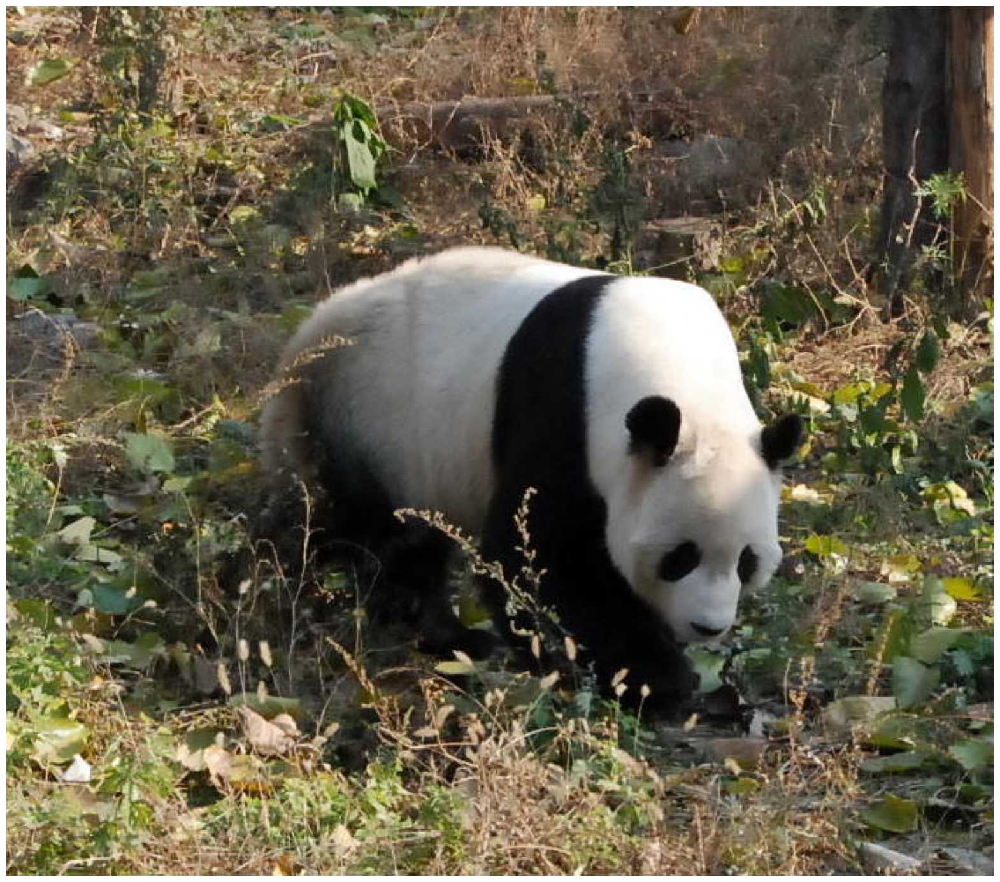

In [4]:
plt.figure(figsize=(20,20))
plt.imshow(image)
plt.axis('off')
plt.show()

In [6]:
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator, SamPredictor

sam_checkpoint = "/mnt/d/zoo/sam_vit_l_0b3195.pth"
model_type = "vit_l"

device = "cuda"

In [ ]:
sam = sam_model_registry[model_type](checkpoint=sam_checkpoint)
sam.to(device=device)

In [9]:
mask_generator = SamAutomaticMaskGenerator(sam)

In [10]:
masks = mask_generator.generate(image)

In [11]:
print(len(masks))
print(masks[0].keys())

161
dict_keys(['segmentation', 'area', 'bbox', 'predicted_iou', 'point_coords', 'stability_score', 'crop_box'])


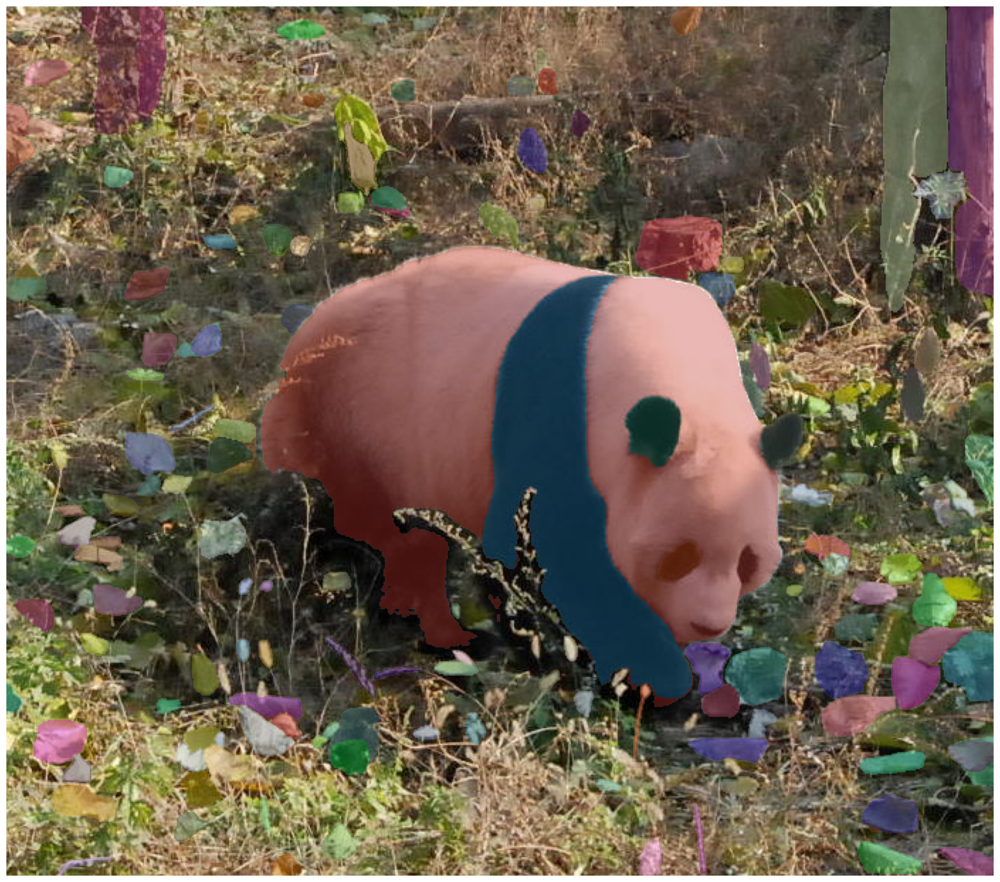

In [12]:
plt.figure(figsize=(20,20))
plt.imshow(image)
show_anns(masks)
plt.axis('off')
plt.show() 

In [13]:
mask_generator_2 = SamAutomaticMaskGenerator(
    model=sam,
    points_per_side=32,
    pred_iou_thresh=0.86,
    stability_score_thresh=0.92,
    crop_n_layers=1,
    crop_n_points_downscale_factor=2,
    min_mask_region_area=100,  # Requires open-cv to run post-processing
)

In [14]:
masks2 = mask_generator_2.generate(image)

In [15]:
len(masks2)

336

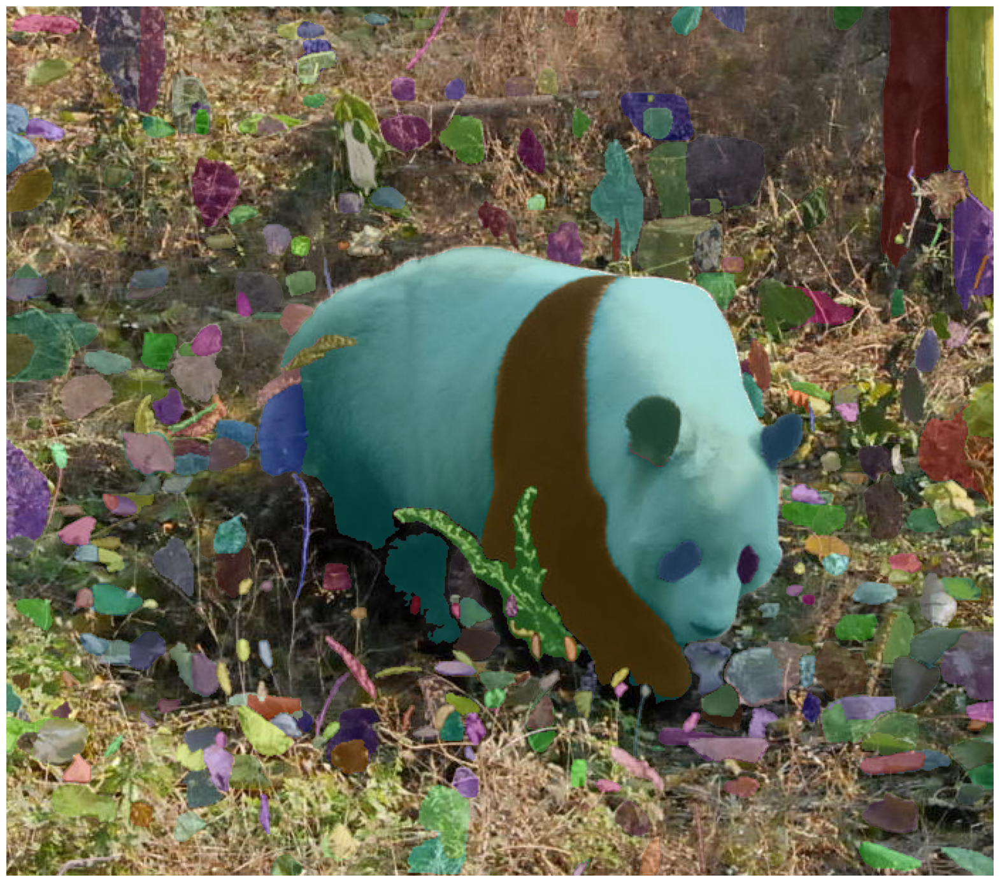

In [16]:
plt.figure(figsize=(20,20))
plt.imshow(image)
show_anns(masks2)
plt.axis('off')
plt.show() 

In [10]:
import json


psnr = {
    'Bicubic': {'Dataset 1': {'16×': 21.5557, '8×': 25.5897}, 'Dataset 2': {'16×': 6.6627, '8×': 5.9304}},
    'RCAN': {'Dataset 1': {'16×': 23.1238, '8×': 29.3926}, 'Dataset 2': {'16×': 5.2764, '8×': 3.3858}},
    # Add other methods similarly
}

ssim = {
    'Bicubic': {'Dataset 1': {'16×': 0.4801, '8×': 0.6607}, 'Dataset 2': {'16×': 0.7043, '8×': 0.8754}},
    'RCAN': {'Dataset 1': {'16×': 0.5779, '8×': 0.7914}, 'Dataset 2': {'16×': 0.6193, '8×': 0.3288}},
    # Add other methods similarly
}

lpips = {
    'Bicubic': {'Dataset 1': {'16×': 0.7338, '8×': 0.4779}, 'Dataset 2': {'16×': 5.5599, '8×': 4.2748}},
    'RCAN': {'Dataset 1': {'16×': 0.5336, '8×': 0.3729}, 'Dataset 2': {'16×': 2.9353, '8×': 1.5634}},
    # Add other methods similarly
}

dists = {
    'Bicubic': {'Dataset 1': {'16×': 0.4842, '8×': 0.2982}, 'Dataset 2': {'16×': 0.8830, '8×': 0.2036}},
    'RCAN': {'Dataset 1': {'16×': 0.3429, '8×': 0.2339}, 'Dataset 2': {'16×': 0.2325, '8×': 0.1333}},
    # Add other methods similarly
}

methods = ['Bicubic', 'RCAN']
scales = ['16×', '8×']
datasets = ['Dataset 1', 'Dataset 2']

def gen_latex_table(psnr, ssim, lpips, dists, methods, scales, datasets, caption):
    def best_vals(values, best_values):
        formatted = []
        for v in values:
            if v == best_values['best']:
                formatted.append('\\textbf{' + f'{v:.4f}' + '}')
            elif v == best_values['second_best']:
                formatted.append('\\underline{' + f'{v:.4f}' + '}')
            else:
                formatted.append(f'{v:.4f}')
        return formatted

    latex_str = r"\begin{table*}[!t]" + "\n"
    latex_str += r"\caption{" + caption + "}" + "\n"
    latex_str += r"\centering" + "\n"
    latex_str += r"\resizebox{\textwidth}{!}{" + "\n"
    latex_str += r"\begin{tabular}{@{} l c " + " ".join(['c c c c ' for _ in datasets]) + "@{}}" + "\n"
    latex_str += r"\toprule" + "\n"
    latex_str += r"\textbf{Methods} & \textbf{Scale} & " + " & ".join([r"\multicolumn{4}{c}{\textbf{" + dataset + "}}" for dataset in datasets]) + r" \\" + "\n"
    latex_str += r"\cmidrule(lr){3-" + str(2 + 4 * len(datasets)) + "}" + "\n"
    latex_str += " & & " + " & ".join([r"\textbf{PSNR $\uparrow$} & \textbf{SSIM $\uparrow$} & \textbf{LPIPS $\downarrow$} & \textbf{DISTS $\downarrow$}" for _ in datasets]) + r" \\" + "\n"
    latex_str += r"\midrule" + "\n"

    for scale in scales:
        scale_values = {metric: [] for metric in ['psnr', 'ssim', 'lpips', 'dists']}
        for method in methods:
            for dataset in datasets:
                scale_values['psnr'].append(psnr[method][dataset][scale])
                scale_values['ssim'].append(ssim[method][dataset][scale])
                scale_values['lpips'].append(lpips[method][dataset][scale])
                scale_values['dists'].append(dists[method][dataset][scale])

        best_metrics = {}
        for metric, values in scale_values.items():
            sorted_values = sorted(values, reverse=True if metric in ['psnr', 'ssim'] else False)
            best_metrics[metric] = {'best': sorted_values[0], 'second_best': sorted_values[1] if len(sorted_values) > 1 else sorted_values[0]}

        for method in methods:
            latex_str += method + " & " + scale + " & "
            for dataset in datasets:
                values = [psnr[method][dataset][scale], ssim[method][dataset][scale], lpips[method][dataset][scale], dists[method][dataset][scale]]
                metrics = ['psnr', 'ssim', 'lpips', 'dists']
                formatted = []
                for idx, val in enumerate(values):
                    metric_best = best_metrics[metrics[idx]]
                    if val == metric_best['best']:
                        formatted.append('\\textbf{' + f'{val:.4f}' + '}')
                    elif val == metric_best['second_best']:
                        formatted.append('\\underline{' + f'{val:.4f}' + '}')
                    else:
                        formatted.append(f'{val:.4f}')
                latex_str += " & ".join(formatted) + " & "
            latex_str = latex_str.strip(" & ") + r" \\" + "\n"
        latex_str += r"\midrule" + "\n"

    latex_str += r"\bottomrule" + "\n"
    latex_str += r"\end{tabular}" + "\n"
    latex_str += r"}" + "\n"
    latex_str += r"\label{table_comparison}" + "\n"
    latex_str += r"\end{table*}"

    return latex_str

caption = "Quantitative comparison of reconstruction quality on different datasets for 16× and 8× scales. The best and second-best results are highlighted in \\textbf{bold} and \\underline{underline}."

latex_code = gen_latex_table(psnr, ssim, lpips, dists, methods, scales, datasets,caption)
print(latex_code)

\begin{table*}[!t]
\caption{Quantitative comparison of reconstruction quality on different datasets for 16× and 8× scales. The best and second-best results are highlighted in \textbf{bold} and \underline{underline}.}
\centering
\resizebox{\textwidth}{!}{
\begin{tabular}{@{} l c c c c c  c c c c @{}}
\toprule
\textbf{Methods} & \textbf{Scale} & \multicolumn{4}{c}{\textbf{Dataset 1}} & \multicolumn{4}{c}{\textbf{Dataset 2}} \\
\cmidrule(lr){3-10}
 & & \textbf{PSNR $\uparrow$} & \textbf{SSIM $\uparrow$} & \textbf{LPIPS $\downarrow$} & \textbf{DISTS $\downarrow$} & \textbf{PSNR $\uparrow$} & \textbf{SSIM $\uparrow$} & \textbf{LPIPS $\downarrow$} & \textbf{DISTS $\downarrow$} \\
\midrule
Bicubic & 16× & \underline{21.5557} & 0.4801 & \underline{0.7338} & 0.4842 & 6.6627 & \textbf{0.7043} & 5.5599 & 0.8830 \\
RCAN & 16× & \textbf{23.1238} & 0.5779 & \textbf{0.5336} & \underline{0.3429} & 5.2764 & \underline{0.6193} & 2.9353 & \textbf{0.2325} \\
\midrule
Bicubic & 8× & \underline{25.5897} & 0

In [4]:
import numpy as np
import plotly.graph_objs as go

# Define the training checkpoints, sharpening factors, and PSNR values
training_checkpoints = [10, 20, 30, 40, 50]
sharpening_factors = [1.0, 1.1, 1.2, 1.3, 1.4]
psnr_a = np.random.randint(20, 50, (len(sharpening_factors), len(training_checkpoints)))
psnr_b = np.random.randint(20, 50, (len(sharpening_factors), len(training_checkpoints)))
psnr_c = np.random.randint(20, 50, (len(sharpening_factors), len(training_checkpoints)))
psnr_d = np.random.randint(20, 50, (len(sharpening_factors), len(training_checkpoints)))

# Define a function to create a 3D scatter plot for each dataset that resembles 3D bars
def create_3d_scatter_chart(title, training_checkpoints, sharpening_factors, psnr_values):
    x, y = np.meshgrid(training_checkpoints, sharpening_factors)
    x = x.ravel()
    y = y.ravel()
    z = np.zeros_like(x)
    dz = psnr_values.ravel()

    scatter_chart = go.Scatter3d(
        x=x,
        y=y,
        z=z,
        mode='markers',
        marker=dict(
            size=dz / 2,
            color=dz,
            colorscale='Viridis',
            opacity=0.8,
            showscale=True
        )
    )
    layout = go.Layout(
        title=title,
        scene=dict(
            xaxis=dict(title='Number of Images'),
            yaxis=dict(title='Sharpening Factor (α)'),
            zaxis=dict(title='PSNR'),
        ),
    )
    return go.Figure(data=[scatter_chart], layout=layout)

# Create 3D scatter charts for each dataset with enhanced realism
fig_a = create_3d_scatter_chart('a) Dataset A', training_checkpoints, sharpening_factors, psnr_a)
fig_b = create_3d_scatter_chart('b) Dataset B', training_checkpoints, sharpening_factors, psnr_b)
fig_c = create_3d_scatter_chart('c) Dataset C', training_checkpoints, sharpening_factors, psnr_c)
fig_d = create_3d_scatter_chart('d) Dataset D', training_checkpoints, sharpening_factors, psnr_d)

# Plot all figures
fig_a.show()
fig_b.show()
fig_c.show()
fig_d.show()

# Scientific interpretation and enhanced comparison
print("Scientific Interpretability:")
print("1. Each plot represents the relationship between Number of Images, Sharpening Factor (α), and PSNR for a specific dataset (A, B, C, D).")
print("2. The X-axis represents the Number of Images, which shows how the PSNR changes as we increase the training data size.")
print("3. The Y-axis represents the Sharpening Factor (α), which indicates different levels of image sharpening intensity applied during preprocessing.")
print("4. The Z-axis represents the PSNR value, which measures the image quality. Higher PSNR generally means better image fidelity.")
print("5. The color gradient (Viridis color scale) represents PSNR value intensity, where warmer colors indicate higher PSNR values and cooler colors indicate lower PSNR values.")
print("6. Within each dataset, readers can observe how the sharpening factor and the number of images influence PSNR. Consistent increases in PSNR with more images suggest improved performance.")
print("7. Comparing across datasets (A, B, C, D) helps identify if certain datasets are more sensitive to sharpening or dataset size. This helps in dataset-specific optimization strategies.")
print("8. The visualization allows readers to identify optimal conditions for each dataset—combinations of sharpening factor and number of images that yield the highest PSNR.")

Scientific Interpretability:
1. Each plot represents the relationship between Number of Images, Sharpening Factor (α), and PSNR for a specific dataset (A, B, C, D).
2. The X-axis represents the Number of Images, which shows how the PSNR changes as we increase the training data size.
3. The Y-axis represents the Sharpening Factor (α), which indicates different levels of image sharpening intensity applied during preprocessing.
4. The Z-axis represents the PSNR value, which measures the image quality. Higher PSNR generally means better image fidelity.
5. The color gradient (Viridis color scale) represents PSNR value intensity, where warmer colors indicate higher PSNR values and cooler colors indicate lower PSNR values.
6. Within each dataset, readers can observe how the sharpening factor and the number of images influence PSNR. Consistent increases in PSNR with more images suggest improved performance.
7. Comparing across datasets (A, B, C, D) helps identify if certain datasets are more s

In [5]:
import numpy as np
from mayavi import mlab

# Define the training checkpoints, sharpening factors, and PSNR values
training_checkpoints = [10, 20, 30, 40, 50]
sharpening_factors = [1.0, 1.1, 1.2, 1.3, 1.4]
psnr_a = np.random.randint(20, 50, (len(sharpening_factors), len(training_checkpoints)))
psnr_b = np.random.randint(20, 50, (len(sharpening_factors), len(training_checkpoints)))
psnr_c = np.random.randint(20, 50, (len(sharpening_factors), len(training_checkpoints)))
psnr_d = np.random.randint(20, 50, (len(sharpening_factors), len(training_checkpoints)))

# Define a function to create a 3D bar chart for each dataset with Mayavi
def create_3d_bar_chart(title, training_checkpoints, sharpening_factors, psnr_values):
    x, y = np.meshgrid(training_checkpoints, sharpening_factors)
    x = x.ravel()
    y = y.ravel()
    z = np.zeros_like(x)
    dz = psnr_values.ravel()

    # Create the figure
    mlab.figure(title, bgcolor=(1, 1, 1), size=(800, 600))

    # Create bars with shading and lighting
    mlab.barchart(x, y, dz, color=(0.2, 0.4, 0.8), opacity=0.9)

    # Set axis labels
    mlab.axes(xlabel='Number of Images', ylabel='Sharpening Factor (α)', zlabel='PSNR',
               ranges=[min(training_checkpoints), max(training_checkpoints),
                       min(sharpening_factors), max(sharpening_factors),
                       0, np.max(dz)], color=(0, 0, 0))
    mlab.title(title, size=0.5)
    mlab.orientation_axes()

# Create 3D bar charts for each dataset
create_3d_bar_chart('Dataset A', training_checkpoints, sharpening_factors, psnr_a)
create_3d_bar_chart('Dataset B', training_checkpoints, sharpening_factors, psnr_b)
create_3d_bar_chart('Dataset C', training_checkpoints, sharpening_factors, psnr_c)
create_3d_bar_chart('Dataset D', training_checkpoints, sharpening_factors, psnr_d)

# Show the visualization
mlab.show()

# Scientific interpretation and enhanced comparison
print("Scientific Interpretability:")
print("1. Each plot represents the relationship between Number of Images, Sharpening Factor (α), and PSNR for a specific dataset (A, B, C, D).")
print("2. The X-axis represents the Number of Images, which shows how the PSNR changes as we increase the training data size.")
print("3. The Y-axis represents the Sharpening Factor (α), which indicates different levels of image sharpening intensity applied during preprocessing.")
print("4. The Z-axis represents the PSNR value, which measures the image quality. Higher PSNR generally means better image fidelity.")
print("5. The visualization allows readers to identify optimal conditions for each dataset—combinations of sharpening factor and number of images that yield the highest PSNR.")

qt.qpa.plugin: Could not find the Qt platform plugin "wayland" in ""


Scientific Interpretability:
1. Each plot represents the relationship between Number of Images, Sharpening Factor (α), and PSNR for a specific dataset (A, B, C, D).
2. The X-axis represents the Number of Images, which shows how the PSNR changes as we increase the training data size.
3. The Y-axis represents the Sharpening Factor (α), which indicates different levels of image sharpening intensity applied during preprocessing.
4. The Z-axis represents the PSNR value, which measures the image quality. Higher PSNR generally means better image fidelity.
5. The visualization allows readers to identify optimal conditions for each dataset—combinations of sharpening factor and number of images that yield the highest PSNR.


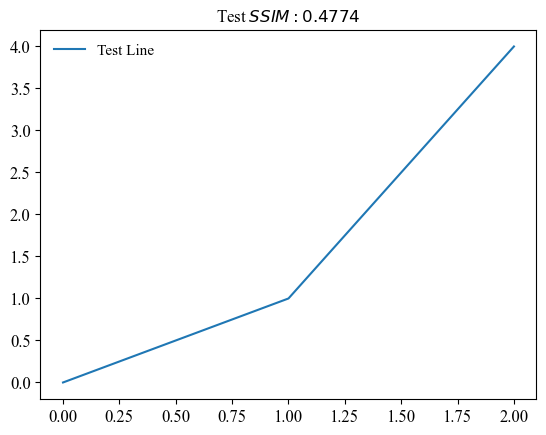

'No errors'

In [3]:
import matplotlib.pyplot as plt

# Attempting to apply the given rcParams settings to check for errors
try:
    plt.rcParams.update(
        {
            "font.family": "serif",
            "font.serif": [
                "Times New Roman",
                "Times",
                "Palatino",
                "serif",
            ],
            "font.sans-serif": [
                "Arial",
                "Liberation Sans",
                "Bitstream Vera Sans",
                "sans-serif",
            ],
            "font.size": 12,
            "axes.labelsize": 12,
            "axes.titlesize": 12,
            "xtick.labelsize": 12,
            "ytick.labelsize": 12,
            "legend.fontsize": 11,
            "lines.linewidth": 1.5,
            "lines.markersize": 5,
            "savefig.dpi": 600,
            "pdf.fonttype": 42,
            "ps.fonttype": 42,
            "legend.frameon": False,
            "text.usetex": False,
             "pgf.texsystem": "pdflatex"
        }
    )
    # Creating a simple plot to test rendering
    fig, ax = plt.subplots()
    ax.plot([0, 1, 2], [0, 1, 4], label="Test Line")
    ax.set_title(r'Test $SSIM: 0.4774$')
    ax.legend()
    plt.show()

except Exception as e:
    error_message = str(e)

error_message if 'error_message' in locals() else "No errors"


In [1]:
import torch
import torch.nn.functional as F
import torchvision
import torchvision.transforms as T
from pytorch_msssim import ssim as ssim_func
from skimage.metrics import peak_signal_noise_ratio
import matplotlib.pyplot as plt
from typing import Tuple, List
from torch.profiler import profile, record_function, ProfilerActivity

In [2]:

def create_2d_hann_window(block_size: int, device: torch.device) -> torch.Tensor:
    hann_1d = torch.hann_window(block_size, periodic=False, device=device)
    hann_2d = hann_1d.unsqueeze(0) * hann_1d.unsqueeze(1)
    return hann_2d

def sparse_window(block_size, device):
    x = torch.linspace(-1, 1, block_size, device=device)
    window = torch.maximum(1 - torch.abs(x), torch.zeros_like(x))
    window_2d = torch.outer(window, window)
    return window_2d

def extract_blocks(img_tensor, block_size, overlap):
    B, C, H, W = img_tensor.shape
    step = block_size - overlap
    pad = block_size // 2
    img_padded = F.pad(img_tensor, (pad, pad, pad, pad), mode='reflect')
    num_blocks_h = (H + 2 * pad - block_size) // step + 1
    num_blocks_w = (W + 2 * pad - block_size) // step + 1
    L = num_blocks_h * num_blocks_w
    all_blocks = torch.zeros((B, L, C, block_size, block_size), device=img_tensor.device)
    for b in range(B):
        idx = 0
        for i in range(0, H + 2 * pad - block_size + 1, step):
            for j in range(0, W + 2 * pad - block_size + 1, step):
                all_blocks[b, idx] = img_padded[b, :, i:i + block_size, j:j + block_size]
                idx += 1
    return all_blocks, (B, C, H, W)

def reconstruct(all_blocks, original_dims, block_size, overlap):
    B, C, H, W = original_dims
    step = block_size - overlap
    pad = block_size // 2
    device = all_blocks.device
    window = create_2d_hann_window(block_size, device).repeat(C, 1, 1)
    recon_padded = torch.zeros((B, C, H + 2 * pad, W + 2 * pad), device=device)
    wsum_padded = torch.zeros((B, C, H + 2 * pad, W + 2 * pad), device=device)
    idx_list = [
        (i, j)
        for i in range(0, H + 2 * pad - block_size + 1, step)
        for j in range(0, W + 2 * pad - block_size + 1, step)
    ]
    for b in range(B):
        for idx, (i, j) in enumerate(idx_list):
            recon_padded[b, :, i:i + block_size, j:j + block_size] += all_blocks[b, idx] * window
            wsum_padded[b, :, i:i + block_size, j:j + block_size] += window
    recon_padded = recon_padded / wsum_padded.clamp_min(1e-8)
    recon = recon_padded[:, :, pad:H + pad, pad:W + pad]
    return recon

def compute_psnr(ref: torch.Tensor, est: torch.Tensor) -> float:
    ref_np = ref.cpu().numpy().transpose(0,2,3,1)
    est_np = est.cpu().detach().numpy().transpose(0,2,3,1)
    psnr_values = [peak_signal_noise_ratio(ref_np[i], est_np[i], data_range=1.0) for i in range(ref_np.shape[0])]
    return sum(psnr_values) / len(psnr_values)

def compute_ssim(ref: torch.Tensor, est: torch.Tensor) -> float:
    ssim_values = [ssim_func(est[i].unsqueeze(0), ref[i].unsqueeze(0), data_range=1.0).item() for i in range(ref.shape[0])]
    return sum(ssim_values) / len(ssim_values)

In [3]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
transform = T.Compose([
    T.Resize((2028, 2048)),
    T.ToTensor()
])
dataset = torchvision.datasets.CIFAR10('/mnt/d/dataset/', train=False, download=True, transform=transform)
dataloader = torch.utils.data.DataLoader(dataset, batch_size=1, shuffle=True)
img, _ = next(iter(dataloader))
img = img.to(device, torch.float32)
block_size = 32
overlap = 8
H , W = img.shape[2], img.shape[3] 

Files already downloaded and verified


Size of blocks: torch.Size([1, 16383, 3, 32, 32])
PSNR: 149.19586730934964 dB
SSIM: 0.9999982118606567
--------------------------  ------------  ------------  ------------  ------------  ------------  ------------  
                      Name    Self CPU %      Self CPU   CPU total %     CPU total  CPU time avg    # of Calls  
--------------------------  ------------  ------------  ------------  ------------  ------------  ------------  
           extract_patches         6.48%     253.748ms        23.94%     936.864ms     936.864ms             1  
                 aten::pad         0.01%     302.785us         0.17%       6.759ms       6.759ms             1  
    aten::reflection_pad2d         0.02%     927.354us         0.16%       6.456ms       6.456ms             1  
               aten::empty         0.00%     109.035us         0.04%       1.565ms     260.893us             6  
             aten::resize_         0.00%      54.368us         0.03%     985.733us     492.866us          

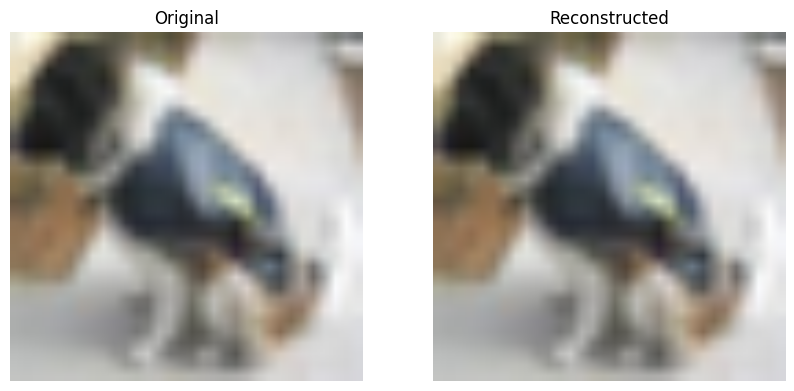

In [4]:
block_size = 32
overlap = 16

with torch.no_grad():
    with profile(activities=[ProfilerActivity.CPU, ProfilerActivity.CUDA], record_shapes=True) as prof:
        with record_function("extract_patches"):
            blocks, orig_dims = extract_blocks(img, block_size, overlap)
        with record_function("reconstruct_image"):
            recon = reconstruct(blocks, orig_dims, block_size, overlap)

print(f"Size of blocks: {blocks.shape}")

p = compute_psnr(img, recon)
s = compute_ssim(img, recon)
print("PSNR:", p, "dB")
print("SSIM:", s)
print(prof.key_averages().table(sort_by="cuda_time_total"))

assert p >= 40, f"PSNR is below 40 dB: {p} dB"
assert s >= 0.99, f"SSIM is below 0.99: {s}."

img_np = img[0].cpu().numpy().transpose(1,2,0)
recon_np = recon[0].detach().cpu().numpy().transpose(1,2,0)

plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
plt.title("Original")
plt.imshow(img_np)
plt.axis('off')

plt.subplot(1,2,2)
plt.title("Reconstructed")
plt.imshow(recon_np)
plt.axis('off')

plt.show()

In [6]:

def hann_window_fold(
        block_size: int, C: int, step: int, device: torch.device
    ) -> torch.Tensor:
        hann_1d = torch.hann_window(block_size, periodic=False, device=device)
        hann_2d = hann_1d.unsqueeze(1) * hann_1d.unsqueeze(0)
        window = hann_2d.view(1, 1, block_size * block_size)
        window = window.repeat(C, 1, 1)
        window = window.view(1, C * block_size * block_size, 1)
        window = window * (
            step / block_size
        )  # Dynamic scaling based on step and block_size
        return window

def extract_blocks_fold(
    img_tensor: torch.Tensor, block_size: int, overlap: int
) -> Tuple[torch.Tensor, Tuple[int, int, int, int, int]]:
    B, C, H, W = img_tensor.shape
    step = block_size - overlap
    pad = (block_size - step) // 2 + step
    img_padded = F.pad(img_tensor, (pad, pad, pad, pad), mode="reflect")
    patches = F.unfold(img_padded, kernel_size=block_size, stride=step)
    window = hann_window_fold(block_size, C, step
                                   , img_tensor.device)
    L = patches.shape[-1]
    window = window.repeat(1, 1, L)
    patches = patches * window
    patches = (
        patches.view(B, C, block_size, block_size, L)
        .permute(0, 4, 1, 2, 3)
        .contiguous()
    )
    return patches, (B, C, H, W, pad)

def reconstruct_fold(
    decoded_patches: torch.Tensor,
    dims: Tuple[int, int, int, int, int],
    block_size_out: int,
    overlap_out: int,
) -> torch.Tensor:
    B, C, H, W, pad_out = dims
    step_out = block_size_out - overlap_out

    if step_out <= 0:
        raise ValueError("Invalid block size and overlap configuration.")
    if H <= 0 or W <= 0:
        raise ValueError("Invalid image dimensions.")

    L_h = (H + 2 * pad_out - block_size_out) // step_out + 1
    L_w = (W + 2 * pad_out - block_size_out) // step_out + 1
    L = L_h * L_w

    if decoded_patches.size(1) != L:
        raise ValueError(
            f"Decoded patches shape mismatch: expected {L}, got {decoded_patches.size(1)}"
        )

    decoded_patches = decoded_patches.reshape(
        B, L, C * block_size_out * block_size_out
    ).permute(0, 2, 1)

    output_size = (H + 2 * pad_out, W + 2 * pad_out)
    recon_padded = F.fold(
        decoded_patches, output_size=output_size, kernel_size=block_size_out, stride=step_out
    )

    window = hann_window_fold(block_size_out, C, step_out, decoded_patches.device)
    window_sum = F.fold(
        torch.ones_like(decoded_patches) * window,
        output_size=output_size,
        kernel_size=block_size_out,
        stride=step_out,
    )
    recon_padded = recon_padded / window_sum.clamp_min(1e-8)

    
    recon = recon_padded[:, :, pad_out:pad_out + H, pad_out:pad_out + W]
    return recon

def compute_psnr(ref: torch.Tensor, est: torch.Tensor) -> float:
    ref_np = ref.cpu().numpy().transpose(0, 2, 3, 1)  # (B, H, W, C)
    est_np = est.cpu().detach().numpy().transpose(0, 2, 3, 1)  # (B, H, W, C)
    psnr_values = [peak_signal_noise_ratio(ref_np[i], est_np[i], data_range=1.0) for i in range(ref_np.shape[0])]
    return sum(psnr_values) / len(psnr_values)

def compute_ssim(ref: torch.Tensor, est: torch.Tensor) -> float:
    
    ssim_values = [
        ssim_func(est[i].unsqueeze(0), ref[i].unsqueeze(0), data_range=1.0).item()
        for i in range(ref.shape[0])
    ]
    return sum(ssim_values) / len(ssim_values)



Size of blocks: torch.Size([1, 7482, 3, 32, 32])
PSNR: 153.87052825997202 dB
SSIM: 0.9999989867210388
--------------------------  ------------  ------------  ------------  ------------  ------------  ------------  
                      Name    Self CPU %      Self CPU   CPU total %     CPU total  CPU time avg    # of Calls  
--------------------------  ------------  ------------  ------------  ------------  ------------  ------------  
           extract_patches         3.64%       3.291ms        21.53%      19.443ms      19.443ms             1  
                 aten::pad         0.12%     107.336us        13.86%      12.517ms      12.517ms             1  
    aten::reflection_pad2d        12.04%      10.877ms        13.74%      12.409ms      12.409ms             1  
               aten::empty         0.52%     470.351us         0.52%     470.351us      39.196us            12  
             aten::resize_         0.33%     300.146us         0.78%     703.047us     117.174us           

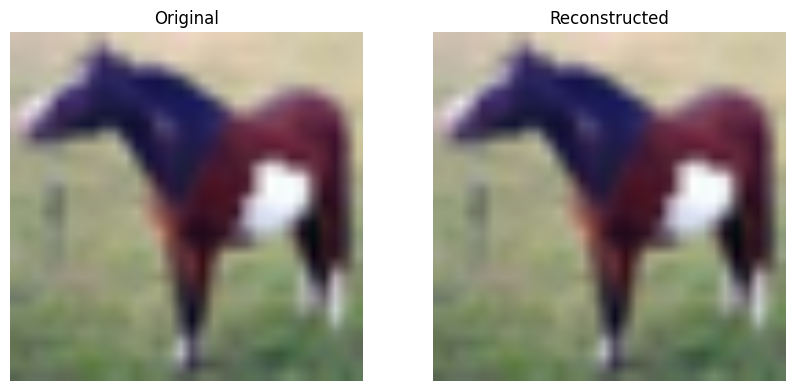

In [7]:
with torch.no_grad():
    with profile(activities=[ProfilerActivity.CPU, ProfilerActivity.CUDA], record_shapes=True) as prof:
        with record_function("extract_patches"):
            patches, orig_dims = extract_blocks_fold(img, block_size, overlap)
        with record_function("reconstruct_image"):
            recon = reconstruct_fold(patches, orig_dims, block_size, overlap)

print(f"Size of blocks: {patches.shape}")

p = compute_psnr(img, recon)
s = compute_ssim(img, recon)
print("PSNR:", p, "dB")
print("SSIM:", s)
print(prof.key_averages().table(sort_by="cuda_time_total"))

assert p >= 40, f"PSNR is below 40 dB: {p} dB"
assert s >= 0.99, f"SSIM is below 0.99: {s}."

img_np = img[0].cpu().numpy().transpose(1, 2, 0)
recon_np = torch.clamp(recon[0], 0, 1).cpu().numpy().transpose(1, 2, 0)

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.title("Original")
plt.imshow(img_np)
plt.axis('off')

plt.subplot(1, 2, 2)
plt.title("Reconstructed")
plt.imshow(recon_np)
plt.axis('off')

plt.show()
